#### This code reproduces the findings of the following scientific article, accepted for publication in npj Materials Degradation journal on 25 September 2023:
### Estimating pitting descriptors of 316L stainless steel by machine learning and statistical analysis
#### _Leonardo Bertolucci Coelho$^{1,2,*}$, Daniel Torres$^{1}$, Vincent Vangrunderbeek$^{2}$, Miguel Bernal$^{1}$, Gian Marco Paldino$^{3}$, Gianluca Bontempi$^{3}$, Jon Ustarroz$^{1,2}$_ 

_$^{1}$ChemSIN – Chemistry of Surfaces, Interfaces and Nanomaterials, Université libre de Bruxelles (ULB), Brussels, Belgium_ 

_$^{2}$Research Group Electrochemical and Surface Engineering (SURF), Vrije Universiteit Brussel, Brussels, Belgium_

_$^{3}$Machine Learning Group (MLG), Université libre de Bruxelles (ULB), Brussels, Belgium_

_*leonardo.bertolucci.coelho@ulb.be_

# 0.005 M NaCl, 100 mV/s

In [1]:
# Import the required libraries
import os
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns

import sklearn
from scipy.stats import kde
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import warnings
from sklearn import metrics
from sklearn.metrics import r2_score
from scipy.signal import argrelmax

In [2]:
# machine learning libraries
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from tensorflow import keras 
import tensorflow as tf
from sklearn.model_selection import KFold

In [3]:
pip install -q tensorflow-model-optimization

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
# Implement a Custom Metric Function in Keras
from keras import backend as K

def coeff_determination(y_true, y_pred):
    SS_res =  K.sum(K.square( y_true-y_pred )) 
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) ) 
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

### datasets uploaded below can be downloaded at: https://data.mendeley.com/datasets/78rz8vw46x/2
Bertolucci Coelho, Leonardo (2023), “Micro-scale potentiodynamic polarisation curves of 316L stainless steel ”, Mendeley Data, V2, doi: 10.17632/78rz8vw46x.2

In [153]:
# choosing the directory for uploading the datasets
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\paper1")

# getting the current directory
%pwd

'C:\\Users\\lbertolu\\OneDrive - Vrije Universiteit Brussel\\ULB\\SECCM tests\\pitting statistics paper draft\\paper1'

In [154]:
df_E=pd.read_csv('E(V)_0.005_M_NaCl_100_mV_per_s.csv') 
E=df_E["E (V)"]
E

0       0.500198
1       0.500809
2       0.501724
3       0.502335
4       0.503250
          ...   
1103    1.350444
1104    1.351360
1105    1.351970
1106    1.352885
1107    1.353496
Name: E (V), Length: 1108, dtype: float64

In [155]:
df=pd.read_csv('j_uA-cm2_0.005_M_NaCl_100_mV_per_s.csv') 
df

,0,1,2,3,4,5,6,7,8,9,...,277,278,279,280,281,282,283,284,285,286
0,136.000808,145.715152,126.286465,136.000808,126.286465,174.858185,194.286859,77.714748,174.858185,184.572516,...,146.213324,140.461707,48.571714,29.143030,29.143030,38.857374,58.286061,58.286061,77.714748,38.857374
1,174.858185,126.286465,145.715152,165.143842,116.572118,106.857775,136.000808,194.286859,126.286465,145.715152,...,144.832030,134.030767,38.857374,68.000404,87.429094,97.143431,87.429094,68.000404,38.857374,58.286061
2,106.857775,136.000808,136.000808,116.572118,165.143842,204.001206,136.000808,165.143842,145.715152,165.143842,...,145.737796,141.254253,58.286061,58.286061,48.571714,87.429094,38.857374,NaN,48.571714,58.286061
3,155.429498,116.572118,145.715152,155.429498,165.143842,136.000808,204.001206,126.286465,174.858185,126.286465,...,146.054815,137.925560,58.286061,68.000404,68.000404,58.286061,38.857374,68.000404,58.286061,68.000404
4,136.000808,145.715152,126.286465,145.715152,145.715152,136.000808,136.000808,204.001206,155.429498,87.429094,...,145.941594,140.461705,77.714748,58.286061,97.143431,38.857374,38.857374,68.000404,68.000404,77.714748
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1103,6333.751760,6246.322857,6226.893858,5935.463650,6887.469633,9160.625572,12570.360436,201086.907075,276781.055305,278393.641837,...,3346.172366,3185.149740,1697.103250,1764.483428,1692.612205,1696.565188,2053.724217,2228.373150,2180.548694,2041.476648
1104,6411.466482,6265.751538,6236.608358,6285.180218,7334.328966,9452.056417,12754.932424,206031.510565,272934.197570,276703.365411,...,3381.327380,3209.435593,1711.203993,1781.520892,1708.319550,1713.087043,2073.862797,2251.201855,2201.763323,2062.280286
1105,6547.467246,6294.894718,6265.751538,6256.037038,7470.329730,10190.346277,11948.642341,210519.530355,284474.831254,275440.502769,...,3408.489009,3236.484032,1725.304736,1798.558356,1724.026895,1729.608898,2094.001377,2274.030560,2222.977953,2083.083924
1106,6644.610649,6362.894940,6217.179677,6372.609121,7023.470078,9306.340835,13289.221616,209431.524882,273245.043090,282813.677001,...,3423.796431,3268.299064,1739.405480,1815.595819,1739.734241,1746.130753,2114.139957,2296.859265,2244.192582,2103.887562


#### filling missing values of j

In [156]:
# Multivariate imputer that estimates each feature from all the others.
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

iter_imputer = IterativeImputer()

# The Iterative Imputer models each feature with missing values as a function of other features, iteratively.
j_nan_filled=iter_imputer.fit_transform(df)
df=pd.DataFrame(j_nan_filled,columns=df.columns)

In [157]:
df_log=np.log10(df)

In [158]:
iter_imputer_log = IterativeImputer()

j_nan_filled_log=iter_imputer_log.fit_transform(df_log)
df_log=pd.DataFrame(j_nan_filled_log,columns=df_log.columns)
df_log

,0,1,2,3,4,5,6,7,8,9,...,277,278,279,280,281,282,283,284,285,286
0,2.133541,2.163505,2.101357,2.133541,2.101357,2.242686,2.288443,1.890503,2.242686,2.266167,...,2.164987,2.147558,1.686383,1.464535,1.464535,1.589473,1.765565,1.765565,1.890503,1.589473
1,2.242686,2.101357,2.163505,2.217862,2.066595,2.028806,2.133541,2.288443,2.101357,2.163505,...,2.160865,2.127205,1.589473,1.832511,1.941656,1.987413,1.941656,1.832511,1.589473,1.765565
2,2.028806,2.133541,2.133541,2.066595,2.217862,2.309633,2.133541,2.217862,2.163505,2.217862,...,2.163572,2.150002,1.765565,1.765565,1.686383,1.941656,1.589473,1.793147,1.686383,1.765565
3,2.191533,2.066595,2.163505,2.191533,2.217862,2.133541,2.309633,2.101357,2.242686,2.101357,...,2.164516,2.139645,1.765565,1.832511,1.832511,1.765565,1.589473,1.832511,1.765565,1.832511
4,2.133541,2.163505,2.101357,2.163505,2.163505,2.133541,2.133541,2.309633,2.191533,1.941656,...,2.164179,2.147558,1.890503,1.765565,1.987413,1.589473,1.589473,1.832511,1.832511,1.890503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1103,3.801661,3.795624,3.794271,3.773455,3.838060,3.961925,4.099348,5.303384,5.442136,5.444659,...,3.524548,3.503130,3.229708,3.246618,3.228557,3.229571,3.312542,3.347988,3.338566,3.309944
1104,3.806957,3.796973,3.794948,3.798318,3.865360,3.975526,4.105678,5.313934,5.436058,5.442014,...,3.529087,3.506429,3.233302,3.250791,3.232569,3.233779,3.316780,3.352414,3.342771,3.314348
1105,3.816073,3.798988,3.796973,3.796299,3.873340,4.008189,4.077319,5.323292,5.454044,5.440028,...,3.532562,3.510073,3.236866,3.254925,3.236544,3.237948,3.320977,3.356796,3.346935,3.318707
1106,3.822470,3.803655,3.793593,3.804317,3.846552,3.968779,4.123500,5.321042,5.436552,5.451500,...,3.534508,3.514322,3.240401,3.259019,3.240483,3.242077,3.325134,3.361134,3.351060,3.323023


### exporting the log(j) curves (missing values filled) as a CSV file

In [168]:
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

df_log.to_csv('logj_uA-cm2_0.005_M_NaCl_100_mV_per_s.csv', index=False)

#### dataset exported above is permanently stored at: https://data.mendeley.com/datasets/7j6b6y48jw/1
Bertolucci Coelho, Leonardo; Ustarroz, Jon (2023), “Micro-scale potentiodynamic polarisation (log(j)) curves of 316L stainless steel”, Mendeley Data, V1, doi: 10.17632/7j6b6y48jw.1

In [160]:
df_log.columns= df_log.columns.astype(int) # converting to int the str cols (Maps) 

### plotting the raw and smoothed log(j) Vs E curves

plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  df_log.columns
for index, column in enumerate(column_names):
    fig, ax = plt.subplots() 
        
    lowess = sm.nonparametric.lowess
    ylow = lowess(df_log[column],E,frac= 0.15,return_sorted=False)

    ax.plot(E , df_log[column], color = "cyan")
    ax.plot(E , ylow, linewidth = 1, color = "black")
    ax.set_title(column)

### storing the smoothed log(j) in dfs

In [12]:
df_ylow_log = df_log.copy()

column_names =  df_log.columns
for index, column in enumerate(column_names):
        
    lowess = sm.nonparametric.lowess
    ylow = lowess(df_log[column],E,frac= 0.2,return_sorted=False) 
    df_ylow_log[column]=ylow

,0,1,2,3,4,5,6,7,8,9,...,277,278,279,280,281,282,283,284,285,286
0,2.136385,2.104751,2.131067,2.141480,2.119913,2.146634,2.172858,2.212185,2.170746,2.178387,...,2.150993,2.143057,1.755974,1.749361,1.766774,1.774239,1.726818,1.758342,1.750218,1.783472
1,2.137616,2.106153,2.132553,2.142992,2.121763,2.148443,2.174665,2.213804,2.172665,2.180049,...,2.151297,2.143303,1.757630,1.750616,1.768128,1.775164,1.727982,1.759197,1.751467,1.784659
2,2.139461,2.108257,2.134783,2.145262,2.124538,2.151156,2.177376,2.216231,2.175544,2.182542,...,2.151753,2.143671,1.760113,1.752501,1.770160,1.776554,1.729726,1.760481,1.753341,1.786441
3,2.140692,2.109659,2.136270,2.146775,2.126387,2.152964,2.179183,2.217849,2.177464,2.184205,...,2.152056,2.143916,1.761768,1.753758,1.771514,1.777481,1.730889,1.761337,1.754590,1.787628
4,2.142539,2.111763,2.138500,2.149046,2.129162,2.155678,2.181894,2.220277,2.180345,2.186699,...,2.152513,2.144284,1.764250,1.755645,1.773546,1.778873,1.732633,1.762621,1.756463,1.789408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1103,3.795223,3.812919,3.816385,3.807247,3.880908,3.995279,4.101814,4.166268,5.759100,5.654170,...,3.503428,3.467604,3.213713,3.239729,3.212091,3.237557,3.322352,3.367939,3.334449,3.298939
1104,3.800222,3.816897,3.820186,3.810941,3.884624,3.999438,4.106145,4.171039,5.772813,5.665408,...,3.507768,3.471519,3.218801,3.246070,3.217867,3.244572,3.329456,3.375769,3.340998,3.305490
1105,3.803557,3.819549,3.822720,3.813403,3.887101,4.002210,4.109032,4.174221,5.781952,5.672897,...,3.510664,3.474133,3.222196,3.250300,3.221720,3.249250,3.334193,3.380990,3.345367,3.309859
1106,3.808558,3.823524,3.826518,3.817095,3.890814,4.006367,4.113362,4.178994,5.795655,5.684127,...,3.515009,3.478059,3.227292,3.256648,3.227504,3.256268,3.341299,3.388820,3.351921,3.316416


In [13]:
df_ylow07_log = df_log.copy()

column_names =  df_log.columns
for index, column in enumerate(column_names):
        
    lowess = sm.nonparametric.lowess
    ylow07 = lowess(df_log[column],E,frac= 0.7,return_sorted=False)
    df_ylow07_log[column]=ylow07

,0,1,2,3,4,5,6,7,8,9,...,277,278,279,280,281,282,283,284,285,286
0,2.141951,2.115388,2.136237,2.159526,2.154740,2.173026,2.181335,2.196012,2.166444,2.134524,...,2.206019,2.193711,1.865725,1.807626,1.858501,1.818259,1.763591,1.756567,1.797437,1.842429
1,2.143240,2.116777,2.137689,2.161038,2.156435,2.174821,2.183250,2.197928,2.168353,2.136425,...,2.206035,2.193641,1.866827,1.808687,1.859411,1.819015,1.764487,1.757350,1.798448,1.843340
2,2.145174,2.118860,2.139868,2.163306,2.158977,2.177513,2.186123,2.200803,2.171215,2.139276,...,2.206058,2.193536,1.868479,1.810277,1.860777,1.820149,1.765830,1.758524,1.799964,1.844706
3,2.146463,2.120249,2.141320,2.164817,2.160671,2.179307,2.188038,2.202719,2.173123,2.141176,...,2.206074,2.193466,1.869580,1.811337,1.861687,1.820905,1.766725,1.759307,1.800975,1.845617
4,2.148396,2.122332,2.143499,2.167085,2.163213,2.181998,2.190910,2.205593,2.175985,2.144027,...,2.206096,2.193361,1.871232,1.812926,1.863052,1.822039,1.768068,1.760481,1.802491,1.846982
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1103,3.276165,3.457245,3.507074,3.513975,3.603721,3.672843,3.780892,3.747222,3.522184,4.208965,...,3.404340,3.437403,2.731770,2.551765,2.650311,2.483016,2.546335,2.497969,2.637576,2.611733
1104,3.277212,3.458477,3.508347,3.515208,3.604946,3.674014,3.782161,3.748295,3.522479,4.211185,...,3.406980,3.440424,2.732220,2.552078,2.650843,2.483540,2.546853,2.498515,2.638135,2.612323
1105,3.277910,3.459300,3.509196,3.516031,3.605764,3.674796,3.783008,3.749012,3.522676,4.212665,...,3.408741,3.442438,2.732520,2.552288,2.651198,2.483890,2.547198,2.498879,2.638508,2.612717
1106,3.278959,3.460535,3.510471,3.517267,3.606991,3.675969,3.784280,3.750087,3.522971,4.214887,...,3.411383,3.445460,2.732970,2.552603,2.651731,2.484416,2.547717,2.499427,2.639068,2.613308


# Epit estimation by rule-based linear regression

## definition of classes of log(j) Vs E curves based on their qualitative degree of similarity 

### providing initial guesses for the Epit intervals and the Epass values (for improved accuracy of estimation)

#### optimized combination for the general class
Epit interval=[1.1,1.2]

Epass=0.9 

In [14]:
Epit_interval_lower = float(input(r"Enter a guess value (V) for the lower limit of the Epit interval: ")) 
Epit_interval_upper = float(input(r"Enter a guess value (V) for the upper limit of the Epit interval: ")) 
Epass_estimated = float(input(r"Enter a guess value (V) for Epass: ")) 
interval_lower_i=E[E>Epit_interval_lower].dropna().index[0]
interval_upper_i=E[E<Epit_interval_upper].dropna().index[-1]
Epass_estimated_i=E[E<Epass_estimated].dropna().index[-1]
print("Epit guessed interval: "+str(round(E[interval_upper_i]-E[interval_lower_i],3))+" V")
print("Epass estimated: "+str(round(E[Epass_estimated_i],3))+" V")

Enter a guess value (V) for the lower limit of the Epit interval: 1.1
Enter a guess value (V) for the upper limit of the Epit interval: 1.2
Enter a guess value (V) for Epass: 0.9
Epit guessed interval: 0.099 V
Epass estimated: 0.899 V


In [15]:
# class1 and class2: early pitting
class1=[19,29,261,267,269,270,277,278] # not distinguished by the underlying electrochemical behaviour, but the different curves' shapes require different input intervals for improved computation
class2=[28,267,277,278] # depression 

#### optimized combination for class1 and class2 
Epit interval=[0.85,1.05]

Epass=0.8  

In [16]:
Epit_interval_lower1 = float(input(r"Enter a guess value (V) for the lower limit of the Epit interval: ")) 
Epit_interval_upper1 = float(input(r"Enter a guess value (V) for the upper limit of the Epit interval: ")) 
Epass_estimated1= float(input(r"Enter a guess value (V) for Epass: ")) 
interval_lower_i1=E[E>Epit_interval_lower1].dropna().index[0]
interval_upper_i1=E[E<Epit_interval_upper1].dropna().index[-1]
Epass_estimated_i1=E[E<Epass_estimated1].dropna().index[-1]
print("Epit guessed interval: "+str(round(E[interval_upper_i1]-E[interval_lower_i1],3))+" V")
print("Epass estimated: "+str(round(E[Epass_estimated_i1],3))+" V")

Enter a guess value (V) for the lower limit of the Epit interval: 0.85
Enter a guess value (V) for the upper limit of the Epit interval: 1.05
Enter a guess value (V) for Epass: 0.8
Epit guessed interval: 0.2 V
Epass estimated: 0.8 V


In [17]:
no_passive_class=[266] # --> out of ML scope # by default, Epit = 0.5 V

## plotting the Epit (E and log(j) pair values) estimated by linear regression

266 no passivity


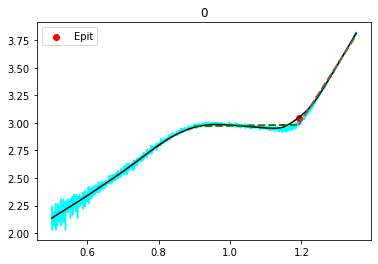

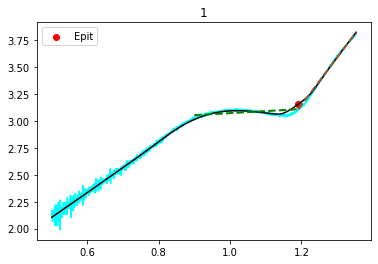

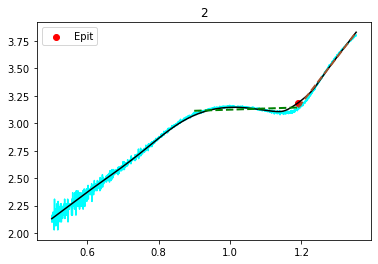

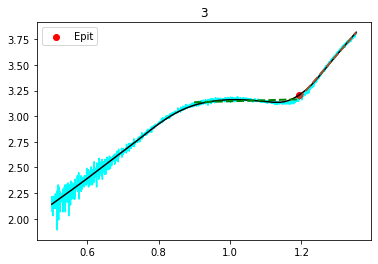

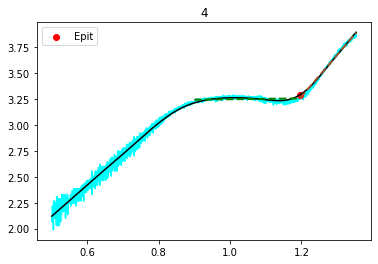

...

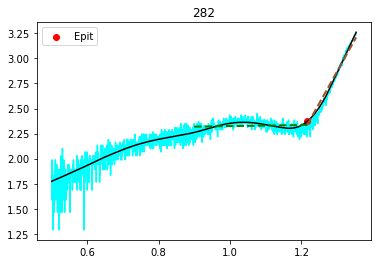

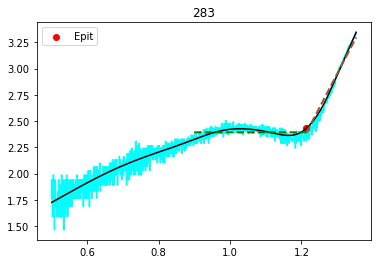

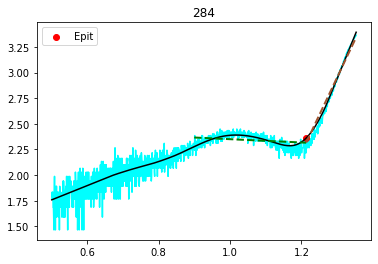

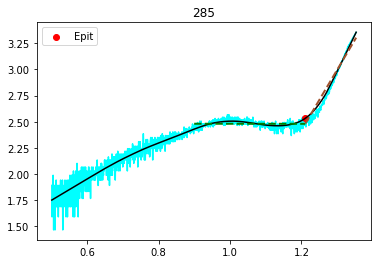

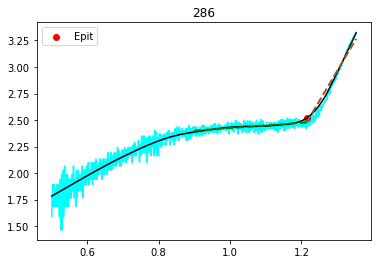

In [65]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  df_ylow_log.columns

#collect all of the slopes and intercepts for the two parts
Epit_E, Epit_j = [],[]

#initialise the two models for part 1 and part 2
model1 = LinearRegression()
model2 = LinearRegression()

for index, column in enumerate(column_names):
    fig, ax = plt.subplots() 
    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)
    ax.set_title(column)

    # Initialize the r2 values
    r2_final1, r2_final2 = 0, 0
    
    if column not in no_passive_class:
        
        if column not in class1+class2: 

            # State which end values for the first part and begin values for the second part should be checked to find the best linear regression
            limits_pit = range(interval_lower_i,interval_upper_i+1,1) # row indexes
            Epass_estimated=Epass_estimated_i
            ylow_log=df_ylow_log
            pass 
            
        elif column in class2: # special treatment

            limits_pit = range(interval_lower_i1,interval_upper_i1+1,1) # row indexes
            Epass_estimated=Epass_estimated_i1
            ylow_log=df_ylow07_log # ylow07
            pass
            
        else: # class1

            limits_pit = range(interval_lower_i1,interval_upper_i1+1,1) 
            Epass_estimated=Epass_estimated_i1
            ylow_log=df_ylow_log
            pass
                     
        for limit in limits_pit:
        
        #split the data into the first part and second part
            dfE_1 =  E.iloc[Epass_estimated:limit+1]
            dfE_2 =  E.iloc[limit:]
            dfj_1 =  ylow_log.iloc[Epass_estimated:limit+1]
            dfj_2 =  ylow_log.iloc[limit:]
            X1,X2 = dfE_1.values.reshape(-1, 1),dfE_2.values.reshape(-1, 1)
            y1,y2 = dfj_1[column].values.reshape(-1, 1),dfj_2[column].values.reshape(-1, 1)

            # Fit models
            regr1, regr2 = model1.fit(X1, y1), model2.fit(X2, y2)
    
            # Evaluate models
            r2_score1, r2_score2 = r2_score(y1, regr1.predict(X1)), r2_score(y2, regr2.predict(X2))

            # Store best models
            if r2_score1 > r2_final1:
                r2_final1, regr_final1 = r2_score1, regr1
            if r2_score2 > r2_final2:
                r2_final2, regr_final2 = r2_score2, regr2

        # Determine intersection
        a1, a2 = regr_final1.coef_[0], regr_final2.coef_[0]
        b1, b2 = regr_final1.intercept_, regr_final2.intercept_

        x_intersect = np.around((b1-b2)/(a2-a1),3) # x value
        E_tempo=E.round(3)
        try:
            xi=E_tempo[E_tempo<=x_intersect.item()].index[-1]
        except:
            xi=E_tempo[E_tempo>=x_intersect.item()].index[0]

        try:
            ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
            # plot the best-fit lines up to the intersection
            x1_reg,x2_reg  = E.iloc[Epass_estimated:xi+1],E.iloc[xi:]
            y1_reg,y2_reg  = x1_reg * a1 + b1,x2_reg * a2 + b2

            ax.plot(x1_reg, y1_reg, linewidth = 2, color = 'green', linestyle = 'dashed')
            ax.plot(x2_reg, y2_reg, linewidth = 2, color = 'sienna', linestyle = 'dashed')
            ax.scatter(E.iloc[xi],df_ylow_log[column].iloc[xi],color="red",label="Epit")
            ax.legend()

            Epit_E.append(E.iloc[xi])
            Epit_j.append(df_ylow_log[column].iloc[xi])

        except: 
            print(column)
            
    else: 
        print(str(column)+" no passivity")
        ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
        ax.scatter(E.iloc[0],df_ylow_log[column].iloc[0],color="red",label="Epit")
        ax.legend()
        Epit_E.append(E.iloc[0])
        Epit_j.append(df_ylow_log[column].iloc[0])

In [31]:
# unsatisfactory Epit estimates from the LR-based algorithm --> ML test set
# list of maps (data samples) with unsatisfactory estimates 
maps_test_list=[17,21,72,184,188,189,253,274]

# Machine Learning

### data pre-processing

To focus specifically on the relevant regions of the PP curves that encompass the pitting descriptors, the log(j) Vs E (smoothed) curves were partitioned through a data slicing procedure. The sliced curves presented 500 data points (0.288 V in potential range), sufficiently capturing the regions related to Epit with high security margins. 

In [66]:
E_sliced=E.iloc[500:1000] 
j_sliced=df_log.iloc[500:1000,:]
j_sliced_smooth=df_ylow_log.iloc[500:1000,:]

### plotting the raw, smoothed and sliced log(j) Vs E curves

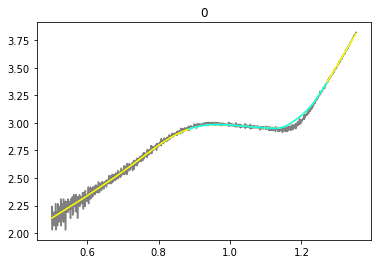

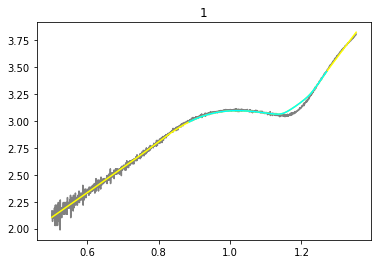

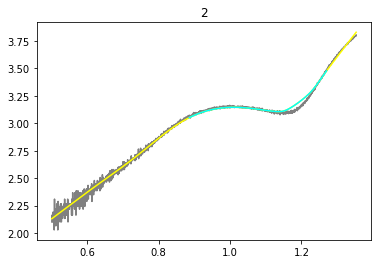

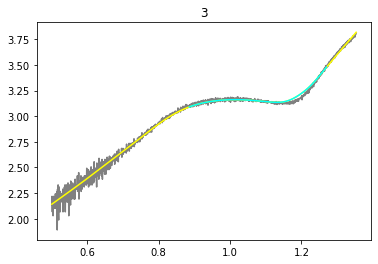

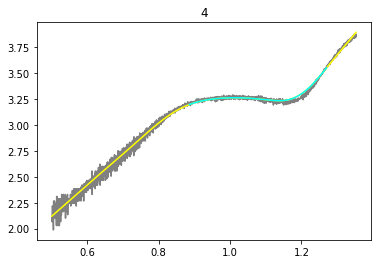

...

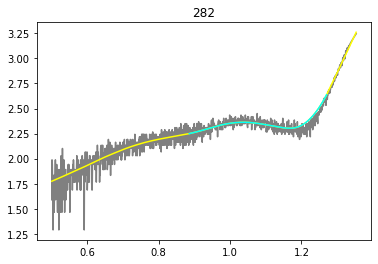

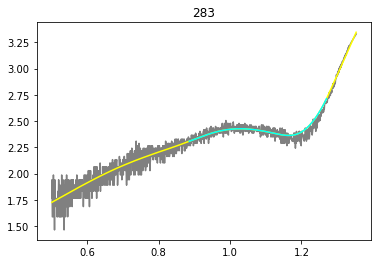

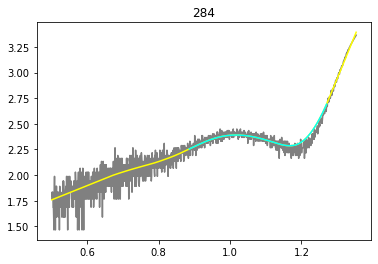

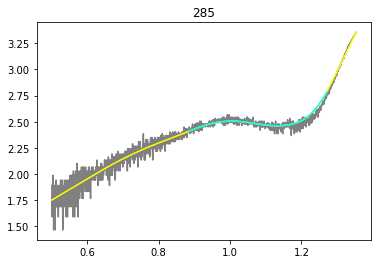

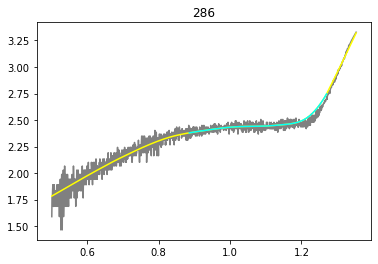

In [67]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  j_sliced.columns 

for index, column in enumerate(column_names):
    if column not in no_passive_class:
    
        fig, ax = plt.subplots()

        ax.plot(E , df_log[column], color = "grey",zorder=1)
        ax.plot(E , df_ylow_log[column], color = "yellow",zorder=2)
        ax.plot(E_sliced , j_sliced_smooth[column], color = "cyan",zorder=3)
        ax.set_title(column)

### feature engineering 

In [68]:
# defining the log(j) values from the sliced curves as data features (columns of the df)
j_transp=j_sliced_smooth.T
j_transp.index.name="Maps"
# selecting the corresponding E (V) stamps of the data features
E_transp=E_sliced.T
E_transp.index.name="Maps"

# drop no_passive_class from features df
j_transp = j_transp.drop(no_passive_class, axis=0) 
j_transp

,500,501,502,503,504,505,506,507,508,509,...,990,991,992,993,994,995,996,997,998,999
Maps,,,,,,,,,,,,,,,,,,,,,
0,2.945347,2.946017,2.947012,2.947993,2.948640,2.949599,2.950230,2.951167,2.951783,2.952697,...,3.324950,3.328113,3.332866,3.336041,3.340810,3.343995,3.348780,3.353574,3.356825,3.361708
1,2.992928,2.993936,2.995437,2.996927,2.997913,2.999383,3.000356,3.001806,3.002766,3.004195,...,3.426254,3.429142,3.433468,3.436348,3.440662,3.443534,3.447836,3.452130,3.454927,3.459111
2,3.051296,3.052281,3.053748,3.055202,3.056165,3.057597,3.058546,3.059957,3.060891,3.062282,...,3.445093,3.447893,3.452086,3.454878,3.459059,3.461843,3.466012,3.470172,3.472879,3.476924
3,3.090876,3.091662,3.092830,3.093986,3.094750,3.095885,3.096635,3.097750,3.098486,3.099581,...,3.449380,3.452006,3.455943,3.458568,3.462504,3.465127,3.469060,3.472990,3.475571,3.479432
4,3.195607,3.196395,3.197564,3.198719,3.199481,3.200612,3.201358,3.202465,3.203196,3.204280,...,3.520577,3.523191,3.527115,3.529733,3.533663,3.536284,3.540218,3.544153,3.546762,3.550663
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,2.249542,2.250020,2.250741,2.251469,2.251957,2.252695,2.253190,2.253937,2.254438,2.255195,...,2.589989,2.593844,2.599670,2.603584,2.609498,2.613470,2.619469,2.625517,2.629972,2.636667
283,2.308370,2.309146,2.310310,2.311475,2.312252,2.313418,2.314196,2.315363,2.316142,2.317310,...,2.666386,2.670326,2.676277,2.680271,2.686303,2.690352,2.696464,2.702623,2.707152,2.713957
284,2.254765,2.255778,2.257297,2.258815,2.259826,2.261342,2.262352,2.263866,2.264874,2.266385,...,2.637218,2.641737,2.648558,2.653135,2.660041,2.664674,2.671664,2.678702,2.683795,2.691439


#### data targeting and data splitting

In [69]:
# defining and selecting the data target (Epit (V))
labels = pd.DataFrame({"Epit_E":Epit_E})
labels.index.name="Maps"
labels = labels.drop(no_passive_class, axis=0)  # drop no_passive_class from target df

# splitting the data into training and test sets
test_labels=labels.loc[maps_test_list] # test set = unsatisfactory Epit estimates 
j_test=j_transp.loc[maps_test_list]
j_train=j_transp.drop(maps_test_list, axis=0)
train_labels=labels.drop(maps_test_list, axis=0)
train_labels 

,Epit_E
Maps,
0,1.192358
1,1.190832
2,1.190832
3,1.192358
4,1.196325
...,...
282,1.216468
283,1.214026
284,1.213416


#### Data Scaling

Given that machine learning algorithms can be sensitive to feature magnitude, we standardize our features to have zero mean and unit variance. This is done using the `StandardScaler()` from `scikit-learn`.

In [70]:
scale_pipe = Pipeline([
    ('scaler', StandardScaler())    
])

j_transp_scaled = scale_pipe.fit_transform(j_transp) 

j_transp_scaled = pd.DataFrame(j_transp_scaled)
j_transp_scaled.index=j_transp.index # getting correct maps (pd.DataFrame reset index)
j_transp_scaled.index.name="Maps"

# splitting the scaled data into training and test sets
j_train_scaled = j_transp_scaled.drop(maps_test_list, axis=0) 
j_test_scaled = j_transp_scaled.loc[maps_test_list,:] 
j_test_scaled
# PS: note that target variables (`labels`) are not scaled since they represent actual output values we aim to predict

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
Maps,,,,,,,,,,,,,,,,,,,,,
17,-0.586503,-0.587418,-0.588793,-0.590172,-0.591093,-0.592477,-0.593402,-0.594791,-0.595719,-0.597113,...,-0.083813,-0.086056,-0.089470,-0.091780,-0.095292,-0.097666,-0.101273,-0.104933,-0.107701,-0.111880
21,-0.178284,-0.177994,-0.177559,-0.177126,-0.176838,-0.176408,-0.176123,-0.175697,-0.175415,-0.174994,...,-0.157646,-0.159080,-0.161269,-0.162752,-0.165013,-0.166544,-0.168875,-0.171246,-0.173116,-0.175937
72,-0.978801,-0.980364,-0.982680,-0.984961,-0.986462,-0.988687,-0.990151,-0.992318,-0.993744,-0.995856,...,-0.248623,-0.230863,-0.202552,-0.182632,-0.151355,-0.129682,-0.096159,-0.061707,-0.028974,0.019628
184,-1.976933,-1.976272,-1.975277,-1.974279,-1.973612,-1.972611,-1.971942,-1.970939,-1.970270,-1.969266,...,-0.094862,-0.086007,-0.071710,-0.061476,-0.045045,-0.033368,-0.014787,0.005004,0.005569,0.005830
188,-1.441990,-1.441442,-1.440602,-1.439739,-1.439151,-1.438250,-1.437638,-1.436701,-1.436064,-1.435092,...,-0.301353,-0.303099,-0.305656,-0.307334,-0.309839,-0.311521,-0.314107,-0.316825,-0.324781,-0.336852
189,-1.031070,-1.031208,-1.031415,-1.031623,-1.031761,-1.031968,-1.032106,-1.032312,-1.032449,-1.032653,...,-0.422571,-0.426430,-0.432261,-0.436187,-0.442147,-0.446178,-0.452332,-0.458637,-0.466771,-0.478941
253,2.148788,2.149078,2.149547,2.150057,2.150419,2.150995,2.151400,2.152040,2.152487,2.153187,...,3.364753,3.359232,3.350908,3.345324,3.336892,3.331229,3.322669,3.314026,3.308852,3.301039
274,1.416475,1.417374,1.418755,1.420173,1.421138,1.422615,1.423620,1.425155,1.426196,1.427785,...,2.869653,2.863957,2.855361,2.849589,2.840869,2.835010,2.826150,2.817203,2.811607,2.803155


## Artificial neural networks

- [Neural networks for regresion with tensorflow](https://nyandwi.com/machine_learning_complete/26_neural_networks_for_regresion_with_tensorflow/)

### Epit model

#### selection of input features 
- [feature reduction](https://scikit-learn.org/stable/modules/feature_selection.html)

In [71]:
# reducing the complexity of the log(j) data by diminishing its dimensionality: selecting every 40th feature from the "j_transp_scaled" df
j_transp_scaled_red=j_transp_scaled.copy()
j_transp_scaled_red=j_transp_scaled_red[np.arange(0,j_transp_scaled.shape[1],40)]
j_transp_scaled_red

j_train_scaled_red=j_train_scaled.copy()
j_train_scaled_red=j_train_scaled_red[np.arange(0,j_train_scaled.shape[1],40)]
j_train_scaled_red

j_test_scaled_red=j_test_scaled.copy()
j_test_scaled_red=j_test_scaled_red[np.arange(0,j_test_scaled.shape[1],40)]
j_test_scaled_red

,0,40,80,120,160,200,240,280,320,360,400,440,480
Maps,,,,,,,,,,,,,
17,-0.586503,-0.633804,-0.683818,-0.729616,-0.757090,-0.750525,-0.697109,-0.543052,-0.349775,-0.175787,-0.039879,0.002269,-0.058038
21,-0.178284,-0.166006,-0.164386,-0.174389,-0.193834,-0.214071,-0.227052,-0.181474,-0.124674,-0.104297,-0.096327,-0.100610,-0.141347
72,-0.978801,-1.039404,-1.070143,-1.081698,-1.092720,-1.095733,-1.069104,-0.956987,-0.781863,-0.605580,-0.478514,-0.441508,-0.392521
184,-1.976933,-1.943247,-1.916807,-1.908952,-1.921806,-1.945532,-1.965172,-1.890861,-1.672613,-1.258016,-0.716012,-0.288684,-0.170181
188,-1.441990,-1.403069,-1.352623,-1.304121,-1.262100,-1.232537,-1.217829,-1.160531,-0.987429,-0.670145,-0.198553,-0.129120,-0.275347
189,-1.031070,-1.036014,-1.035051,-1.033374,-1.020926,-1.005672,-0.998679,-0.963877,-0.868614,-0.638008,-0.259529,-0.156149,-0.374836
253,2.148788,2.181103,2.236368,2.308053,2.372577,2.450726,2.558105,2.997116,3.259939,3.471715,3.593802,3.648086,3.432592
274,1.416475,1.476915,1.551199,1.637426,1.733724,1.844817,1.974540,2.425415,2.806691,3.064068,3.181546,3.177184,2.939057


#### visualising the non-scaled / scaled features (sliced log(j)) and the 13 selected input features

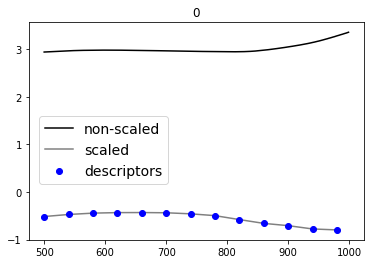

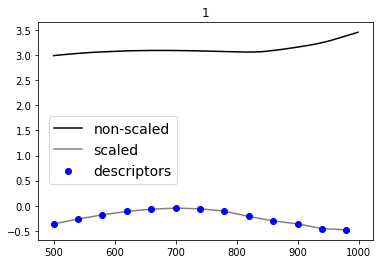

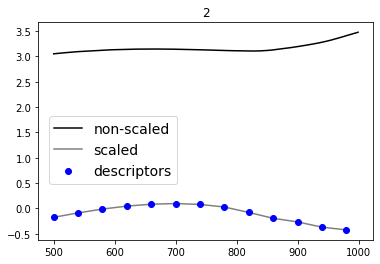

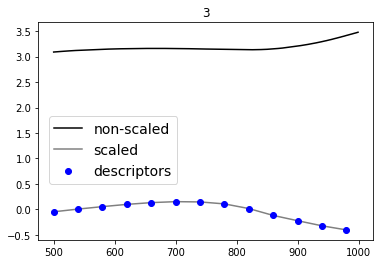

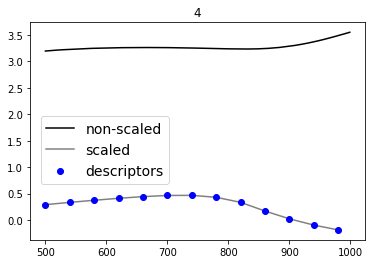

...

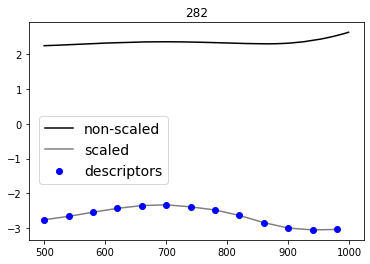

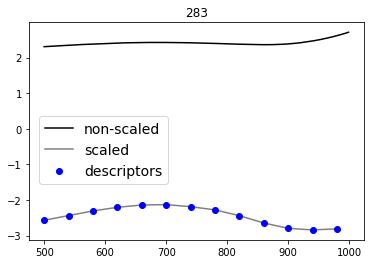

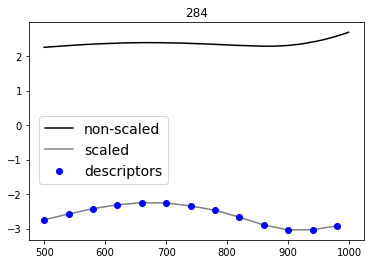

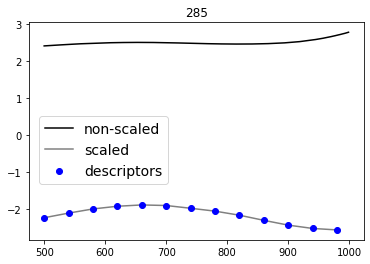

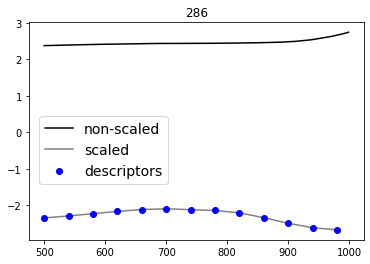

In [72]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

index_names =  j_transp_scaled_red.index 

for index in index_names:
    fig, ax = plt.subplots() 
    
    ax.plot(j_transp.loc[index,:], color = "k",zorder=1,label="non-scaled")
    ax.plot(j_transp_scaled_red.columns+j_transp.columns[0],j_transp_scaled_red.loc[index,:], color = "grey",zorder=1,label="scaled")
    ax.scatter(j_transp_scaled_red.loc[index,:].index+j_transp.columns[0],j_transp_scaled_red.loc[index,:],c="b",zorder=2,label="descriptors")
    ax.set_title(index)
    ax.legend(loc="upper left",bbox_to_anchor=(0.01,0.6),prop={'size': 14})

#### Setting Up Neural Network Parameters

Here, we configure our neural network's input shape based on the number of features in the dataset. Additionally, we define training parameters:

- **input_shape**: Represents the number of features and must be defined as a tuple for compatibility with the neural network framework.
- **epochs**: Number of passes through the entire training dataset.
- **batches**: Size of data chunks processed by the neural network during each iteration. 

In our setup, we are using a batch size equal to the total number of training samples. This method, often referred to as "batch gradient descent" or "full-batch" training, has its merits:

- **Optimal Gradient Estimates**: Using the entire dataset provides a precise gradient computation, promoting stable weight updates and potentially faster convergence.
- **Deterministic Updates**: Full-batch training ensures consistent weight updates across iterations, offering predictability and easier debugging.

In [73]:
input_shape = j_transp_scaled_red.shape[1] 
input_shape=(input_shape,) 
input_shape 

epochs=200

batches=int(j_train_scaled_red.shape[0])
batches 

278

#### Cross-validation for Neural Network Training

To achieve a more robust evaluation during initial training, we utilize cross-validation. Specifically, we've chosen K-fold cross-validation, which partitions our dataset into \( K \) different folds and trains/tests the model \( K \) times, each time with a different fold as the test set.

Our neural network architecture is designed for a regression problem:

- **Input Layer**: Matches the number of features in our dataset. Uses the ReLU activation function.
- **Hidden Layer 1**: Contains 12 nodes and uses ReLU.
- **Hidden Layer 2**: Contains 11 nodes and uses ReLU.
- **Output Layer**: A single node without any activation function, suitable for regression tasks, providing continuous output values.

Note: Neural networks with two hidden layers can theoretically model any function shape, eliminating the need for additional layers in many cases

- [Evaluate Performance of Deep Learning Models with Keras](https://machinelearningmastery.com/evaluate-performance-deep-learning-models-keras/)

In [122]:
#### Neural Network Training with Cross-validation:

def cross_validate(X, y, K=10, **kwargs):
    scores = []
    histories = []
    for train, test in KFold(n_splits=K, shuffle=True).split(X,y): 
        # compiling the model
        model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])
        histories.append(model.fit(X.iloc[train], y.iloc[train], validation_data=(X.iloc[test],y.iloc[test]), batch_size=batches, epochs=epochs))
        # using "model.fit" in the same code block (for restarting from the initial epoch each time)
        scores.append(model.evaluate(X.iloc[test], y.iloc[test], verbose=0))
        
        print("\nval_loss:", round(np.asarray(scores)[-1,0], 4))
        print("val_R2:", round(np.asarray(scores)[-1,1], 4), "\n")
        
    print(scores)
    print("\nmean R2:", round(np.asarray(scores)[:,1].mean(), 4))
    
    return scores, histories

# Model Definition
model = keras.models.Sequential([
    keras.layers.Dense(input_shape[0], activation='relu', input_shape=input_shape),
    keras.layers.Dense(12, activation='relu'),
    keras.layers.Dense(11, activation='relu'),
    keras.layers.Dense(1)         
])

scores, histories = cross_validate(j_train_scaled_red, train_labels, K=20)

Epoch 1/200
1/1 [==============================] - 1s 501ms/step - loss: 5.2532 - coeff_determination: -5005.8457 - val_loss: 3.3440 - val_coeff_determination: -14729.8379
Epoch 2/200
1/1 [==============================] - 0s 24ms/step - loss: 5.0870 - coeff_determination: -4847.3794 - val_loss: 3.2443 - val_coeff_determination: -14290.8418
Epoch 3/200
1/1 [==============================] - 0s 37ms/step - loss: 4.9251 - coeff_determination: -4693.1445 - val_loss: 3.1449 - val_coeff_determination: -13853.0215
Epoch 4/200
1/1 [==============================] - 0s 28ms/step - loss: 4.7674 - coeff_determination: -4542.7725 - val_loss: 3.0471 - val_coeff_determination: -13421.8428
Epoch 5/200
1/1 [==============================] - 0s 27ms/step - loss: 4.6134 - coeff_determination: -4396.0371 - val_loss: 2.9511 - val_coeff_determination: -12999.2539
Epoch 6/200
1/1 [==============================] - 0s 27ms/step - loss: 4.4622 - coeff_determination: -4251.9448 - val_loss: 2.8560 - val_coeff_

#### Model Training Histories

The below visualizations represent the history of our model training (learning curves) through 20-fold cross-validation. The `loss` ('mean_squared_error') and `R-squared` metrics have been monitored for both training and validation sets.

- **Loss:** This metric represents how well our predictions match the actual values (the lower the loss, the better).
    - Blue Line: Training Loss
    - Orange Line: Validation Loss

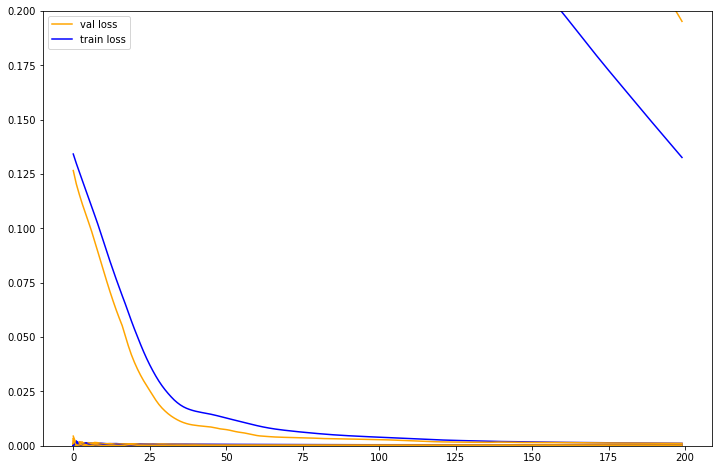

In [76]:
fig, ax = plt.subplots(figsize=(12,8)) 
for h in histories:
    ax.plot(h.history["loss"],c="b")
    ax.plot(h.history["val_loss"],c="orange")

ax.plot(0,0,c="orange",label="val loss") # plot for the sake of the legend label
ax.plot(0,0,c="b",label="train loss") # plot for the sake of the legend label
ax.set_ylim(0,0.2)
ax.legend()

- **R-squared:** the coefficient of determination measures of how well the model's predictions match the actual values. A value of 1 indicates perfect predictions.
    - Blue Line: Training R-squared
    - Orange Line: Validation R-squared

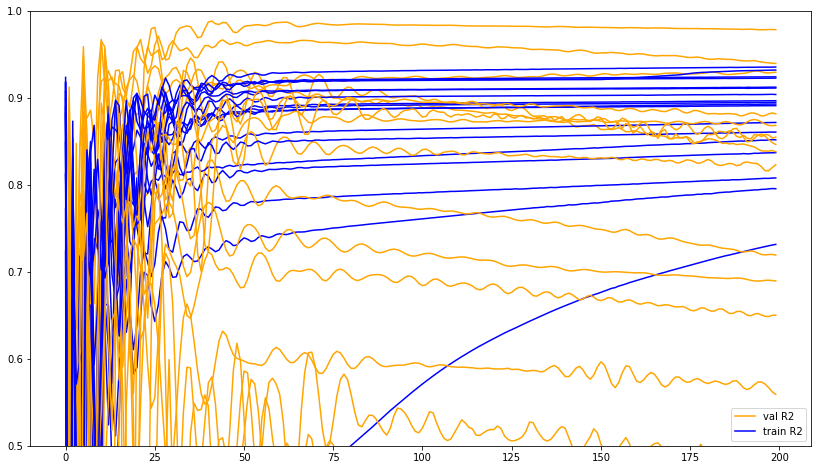

In [77]:
fig, ax = plt.subplots(figsize=(14,8)) 
for h in histories:
    ax.plot(h.history["coeff_determination"],c="b")
    ax.plot(h.history["val_coeff_determination"],c="orange")

ax.plot(0,0,c="orange",label="val R2") # plot for the sake of the legend label
ax.plot(0,0,c="b",label="train R2") # plot for the sake of the legend label
ax.set_ylim(0.5,1)
ax.legend()

In [78]:
# Model Architecture
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 13)                182       
                                                                 
 dense_13 (Dense)            (None, 12)                168       
                                                                 
 dense_14 (Dense)            (None, 11)                143       
                                                                 
 dense_15 (Dense)            (None, 1)                 12        
                                                                 
Total params: 505
Trainable params: 505
Non-trainable params: 0
_________________________________________________________________


#### Re-Training with Model Pruning

1. **Pruning Parameters Setup:** We define a schedule starting from 0% sparsity, aiming to reach 90% by the end of the training (using TensorFlow's Model Optimization Toolkit).
2. **Model Definition:** A neural network is defined again (resetting the model), with the same architecture as before. This model will be subjected to pruning. The number of epochs is expected to increase in the prunned model. We initially attempt increasing by "n": "epochs"=epochs*n
3. **Compile the Model:** The optimizer, loss function, and metrics are specified.
4. **Model Training:** The model is trained with a training split, incorporating the pruning callback. Despite using KFold earlier for validation, here we employ a `validation_split` for simplicity in the training phase.

- [Model Pruning with TensorFlow](https://towardsdatascience.com/model-pruning-in-deep-neural-networks-using-the-tensorflow-api-7cf52bdd32)

In [123]:
n=40 # epochs multiplier

In [124]:
import tensorflow_model_optimization as tfmot
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled.shape[0] / batches).astype(np.int32) * epochs*n
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [125]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape[0], activation='relu',input_shape=input_shape), 
            keras.layers.Dense(12, activation='relu'),  
            keras.layers.Dense(11, activation='relu'), 
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=0.001) # default learning rate

model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model.fit(j_train_scaled_red, train_labels,batch_size=batches,epochs=epochs*n,validation_split=0.1,callbacks=pruning_callback)

Epoch 1/8000
1/1 [==============================] - 0s 495ms/step - loss: 1.0302 - coeff_determination: -1789.1302 - val_loss: 1.4850 - val_coeff_determination: -310.0115
Epoch 2/8000
1/1 [==============================] - 0s 33ms/step - loss: 0.9887 - coeff_determination: -1717.1450 - val_loss: 1.4841 - val_coeff_determination: -309.8198
Epoch 3/8000
1/1 [==============================] - 0s 33ms/step - loss: 0.9484 - coeff_determination: -1647.0376 - val_loss: 1.4681 - val_coeff_determination: -306.4564
Epoch 4/8000
1/1 [==============================] - 0s 33ms/step - loss: 0.9072 - coeff_determination: -1575.4926 - val_loss: 1.4356 - val_coeff_determination: -299.6524
Epoch 5/8000
1/1 [==============================] - 0s 29ms/step - loss: 0.8651 - coeff_determination: -1502.4014 - val_loss: 1.3905 - val_coeff_determination: -290.2162
Epoch 6/8000
1/1 [==============================] - 0s 18ms/step - loss: 0.8242 - coeff_determination: -1431.2629 - val_loss: 1.3399 - val_coeff_dete

#### Full Dataset Training with Model Pruning

The model is trained on the entire dataset without any validation split. The focus here is to prune the model with a significant number of epochs.

**Optimizer Setup:** 
1. decreasing the learning rate of the Adam optimizer
2. fine-tuning the number of epochs of the pruned model

In [126]:
epochs_pruned=10000

lr=0.000000000001 # decreasing the learning rate

In [127]:
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled.shape[0] / batches).astype(np.int32) * epochs_pruned
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [128]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape[0], activation='relu',input_shape=input_shape), 
            keras.layers.Dense(12, activation='relu'),  
            keras.layers.Dense(11, activation='relu'),
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=lr)

model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model.fit(j_train_scaled_red, train_labels,batch_size=batches,epochs=epochs_pruned,callbacks=pruning_callback)

Epoch 1/10000
1/1 [==============================] - 0s 382ms/step - loss: 1.2237 - coeff_determination: -1207.9658
Epoch 2/10000
1/1 [==============================] - 0s 0s/step - loss: 1.1946 - coeff_determination: -1179.1825
Epoch 3/10000
1/1 [==============================] - 0s 0s/step - loss: 1.1664 - coeff_determination: -1151.3798
Epoch 4/10000
1/1 [==============================] - 0s 19ms/step - loss: 1.1390 - coeff_determination: -1124.2169
Epoch 5/10000
1/1 [==============================] - 0s 3ms/step - loss: 1.1120 - coeff_determination: -1097.6072
Epoch 6/10000
1/1 [==============================] - 0s 3ms/step - loss: 1.0855 - coeff_determination: -1071.4520
Epoch 7/10000
1/1 [==============================] - 0s 5ms/step - loss: 1.0596 - coeff_determination: -1045.8121
Epoch 8/10000
1/1 [==============================] - 0s 4ms/step - loss: 1.0341 - coeff_determination: -1020.6411
Epoch 9/10000
1/1 [==============================] - 0s 1ms/step - loss: 1.0090 - coeff

(-1e-05, 0.0001)

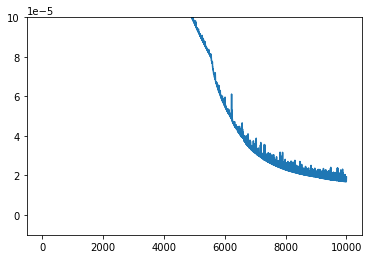

In [85]:
# loss
fig, ax = plt.subplots() 
ax.plot(history.history["loss"])
ax.set_ylim(-0.00001,0.0001)

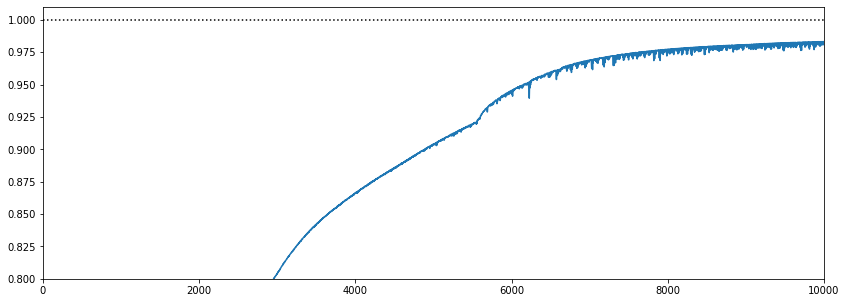

In [86]:
# R²
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["coeff_determination"],label="R²")
ax.set_ylim(0.8,1.01)
ax.set_xlim(0,epochs_pruned)
plt.axhline(y = 1, color = 'k', linestyle = 'dotted')

updating the number of epochs for the pruned model (for additional optimization)

In [143]:
epochs_pruned=4500 # decreasing the number of epochs
     
lr=0.000000000001 

In [144]:
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled.shape[0] / batches).astype(np.int32) * epochs_pruned
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [145]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape[0], activation='relu',input_shape=input_shape), 
            keras.layers.Dense(12, activation='relu'), 
            keras.layers.Dense(11, activation='relu'),
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=lr)

model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model.fit(j_train_scaled_red, train_labels,batch_size=batches,epochs=epochs_pruned,callbacks=pruning_callback)

Epoch 1/4500
1/1 [==============================] - 1s 668ms/step - loss: 1.1714 - coeff_determination: -1156.2333
Epoch 2/4500
1/1 [==============================] - 0s 5ms/step - loss: 1.1129 - coeff_determination: -1098.5177
Epoch 3/4500
1/1 [==============================] - 0s 5ms/step - loss: 1.0568 - coeff_determination: -1043.0630
Epoch 4/4500
1/1 [==============================] - 0s 5ms/step - loss: 1.0035 - coeff_determination: -990.4326
Epoch 5/4500
1/1 [==============================] - 0s 6ms/step - loss: 0.9533 - coeff_determination: -940.8352
Epoch 6/4500
1/1 [==============================] - 0s 2ms/step - loss: 0.9063 - coeff_determination: -894.4117
Epoch 7/4500
1/1 [==============================] - 0s 7ms/step - loss: 0.8626 - coeff_determination: -851.1846
Epoch 8/4500
1/1 [==============================] - 0s 6ms/step - loss: 0.8221 - coeff_determination: -811.1724
Epoch 9/4500
1/1 [==============================] - 0s 5ms/step - loss: 0.7847 - coeff_determinatio

(-1e-05, 0.001)

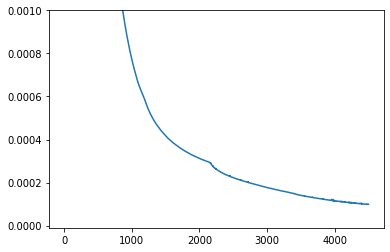

In [146]:
# loss
fig, ax = plt.subplots() 
ax.plot(history.history["loss"])
ax.set_ylim(-0.00001,0.001)

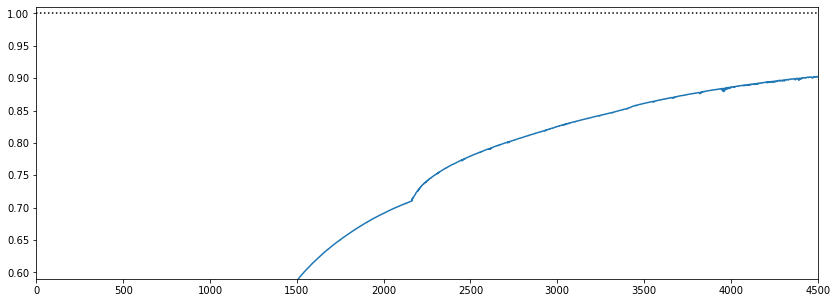

In [147]:
# R²
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["coeff_determination"])
ax.set_ylim(0.59,1.01)
ax.set_xlim(0,epochs_pruned)
plt.axhline(y = 1, color = 'k', linestyle = 'dotted')

#### deploying the trained model on the test set

In [148]:
predict_test=model.predict(j_test_scaled_red) 
predict_test

1/1 [==============================] - 0s 107ms/step


array([[1.1091306],
       [1.1650333],
       [1.128326 ],
       [1.1248611],
       [1.0960957],
       [1.1131501],
       [1.1232728],
       [1.1003982]], dtype=float32)

#### plotting the Epit estimates superimposed to the test data samples (row/smoothed log(j) Vs E curves)

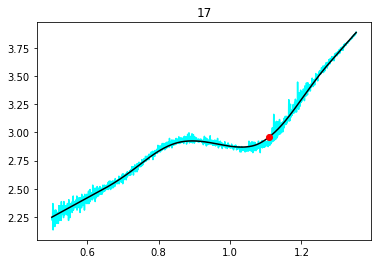

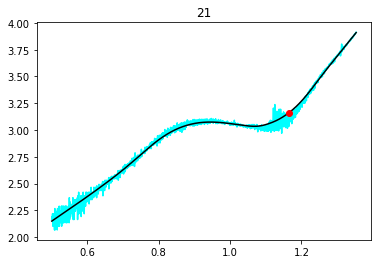

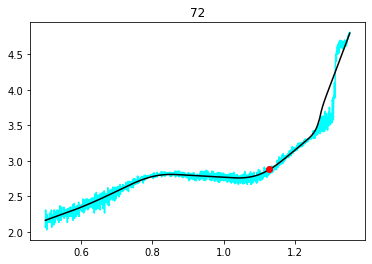

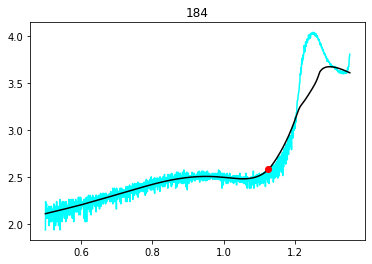

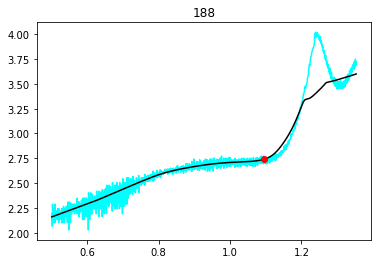

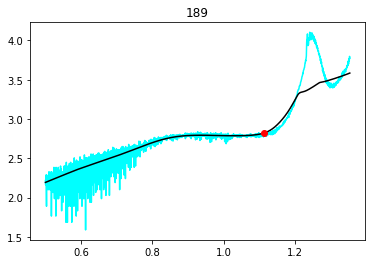

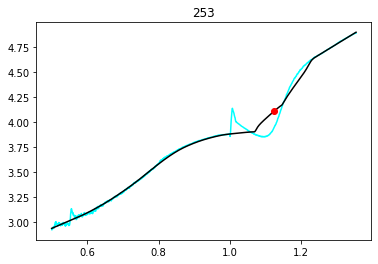

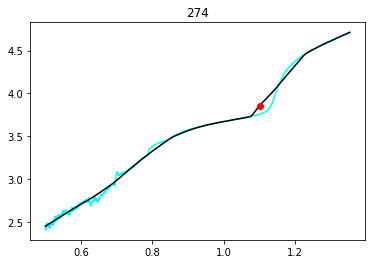

In [149]:
index_names =  j_test_scaled_red.index 

for index, column in enumerate(index_names):
    fig, ax = plt.subplots() 
    ax.set_title(column)    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)
    ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
    ax.scatter(predict_test[index][0], df_ylow_log[column][E>=predict_test[index][0]].iloc[0], color = "red",zorder=3)
# log(jpit) was calculated from the output Epit (log(j) is a function of E)

#### performance evaluation on training set

Note: we only dispose of the labels for the training set. The test set comprises the unsatisfactory estimates obtained with the rule-based LR (reason for leveraging ANN was precisely to improve the quality of these estimates)

9/9 [==============================] - 0s 1ms/step


Text(0.5, 1.0, 'Epit')

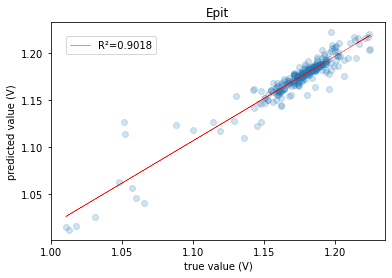

In [150]:
predict_train=model.predict(j_train_scaled_red)
R2=round(r2_score(train_labels, predict_train),4)

fig, ax = plt.subplots()

ax.scatter(train_labels,predict_train,alpha=0.2)
ax.set_ylabel("predicted value (V)")
ax.set_xlabel("true value (V)")

#obtain m (slope) and b (intercept) of linear regression line
x=train_labels["Epit_E"]
model_lin = np.polyfit(x,predict_train.flatten(),1)
ax.plot(x, model_lin[0]*x+model_lin[1],c="r",linewidth=0.5,label="R²="+str(R2))

fig.legend(loc="upper left", bbox_to_anchor=(0.15, 0.85))
ax.set_title('Epit')

### storing the Epit (x,y) values in a df

In [151]:
index_names =  j_transp_scaled.index 

predict_entire=model.predict(j_transp_scaled_red) # deploying the trained model on the entire (training + test) set

Epit_x, Epit_y = [],[]
for e,(index,column) in zip(predict_entire,enumerate(index_names)):
    Epit_x.append(e[0])
    Epit_y.append(df_ylow_log[column][E>=predict_entire[index][0]].iloc[0])
    
pit_log = pd.DataFrame({"Epit_x":Epit_x,"Epit_y":Epit_y})
pit_log.index=j_transp_scaled.index
pit_log.index.name="Maps"
pit_log 

9/9 [==============================] - 0s 0s/step


,Epit_x,Epit_y
Maps,,
0,1.188024,3.039450
1,1.188121,3.150247
2,1.203229,3.217619
3,1.199036,3.220914
4,1.193985,3.287829
...,...,...
282,1.215769,2.371717
283,1.214112,2.434362
284,1.217054,2.374503


In [152]:
# inserting data samples from no_passive_class (Epass = 0.5 V by default)
Epit_x_no_pass, Epit_y_no_pass = [],[]
for i in no_passive_class:
    Epit_x_no_pass.append(Epit_E[i])
    Epit_y_no_pass.append(Epit_j[i])
    
pit_log_no_pass = pd.DataFrame({"Epit_x":Epit_x_no_pass,"Epit_y":Epit_y_no_pass})
pit_log_no_pass.index=no_passive_class
pit_log_no_pass.index.name="Maps"

pit_log=pit_log.append(pit_log_no_pass) # run this only once
pit_log.sort_index(ascending=True,inplace=True)
pit_log 

,Epit_x,Epit_y
Maps,,
0,1.188024,3.039450
1,1.188121,3.150247
2,1.203229,3.217619
3,1.199036,3.220914
4,1.193985,3.287829
...,...,...
282,1.215769,2.371717
283,1.214112,2.434362
284,1.217054,2.374503


# Epass estimation by rule-based linear regression

### providing initial guesses for the Epass intervals (for improved accuracy of estimation)

#### optimized combination for the general class
Epass interval=[0.6,0.9]

In [59]:
Epass_interval_lower = float(input(r"Enter a guess value (V) for the lower limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
Epass_interval_upper = float(input(r"Enter a guess value (V) for the upper limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
interval_lower_ipass=E[E>Epass_interval_lower].dropna().index[0]
interval_upper_ipass=E[E<Epass_interval_upper].dropna().index[-1]
print("Epass guessed interval: "+str(round(E[interval_upper_ipass]-E[interval_lower_ipass],3))+" V")

Enter a guess value (V) for the lower limit of the Epass interval: 0.6
Enter a guess value (V) for the upper limit of the Epass interval: 0.9
Epass guessed interval: 0.299 V


In [60]:
class3=[200,250,252,253,256,258,260,263,265,268,274] # pseudo-passivity 

#### optimized combination for class3
Epass interval=[0.6,1]

In [61]:
Epass_interval_lower3 = float(input(r"Enter a guess value (V) for the lower limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
Epass_interval_upper3 = float(input(r"Enter a guess value (V) for the upper limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
interval_lower_ipass3=E[E>Epass_interval_lower3].dropna().index[0]
interval_upper_ipass3=E[E<Epass_interval_upper3].dropna().index[-1]
print("Epass guessed interval: "+str(round(E[interval_upper_ipass3]-E[interval_lower_ipass3],3))+" V")

Enter a guess value (V) for the lower limit of the Epass interval: 0.6
Enter a guess value (V) for the upper limit of the Epass interval: 1
Epass guessed interval: 0.399 V


### providing initial guesses for the E interval comprising the log(j) maxima

#### optimized combination for finding the maxima
Epass interval=[0.6,1.1]

In [62]:
limits_max_lower = float(input(r"Enter a guess value (V) for the lower limit of the max value: ")) #'r' --> a character following a backslash is included in the string without change
limits_max_upper = float(input(r"Enter a guess value (V) for the upper limit of the max value: ")) #'r' --> a character following a backslash is included in the string without change
limits_max_lower_i=E[E>limits_max_lower].dropna().index[0]
limits_max_upper_i=E[E<limits_max_upper].dropna().index[-1]
print("max values interval estimation: "+str(round(E[limits_max_upper_i]-E[limits_max_lower_i],3))+" V")

Enter a guess value (V) for the lower limit of the max value: 0.6
Enter a guess value (V) for the upper limit of the max value: 1.1
max values interval estimation: 0.5 V


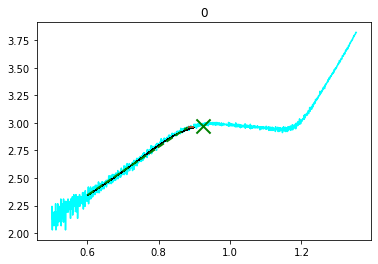

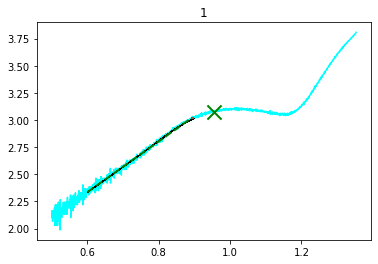

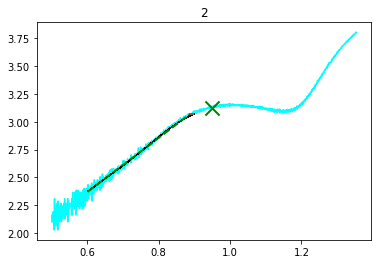

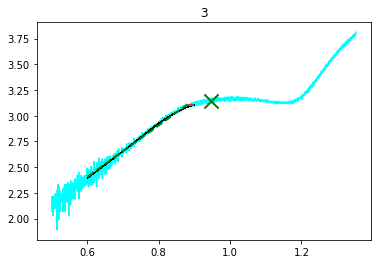

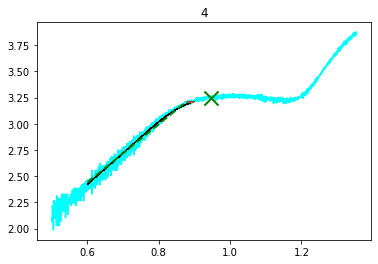

...

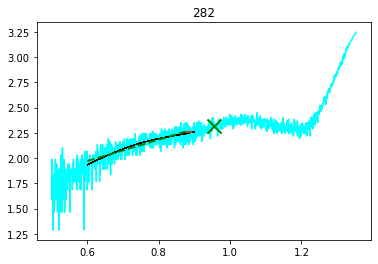

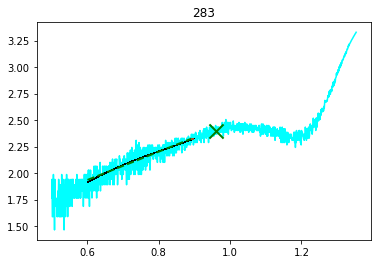

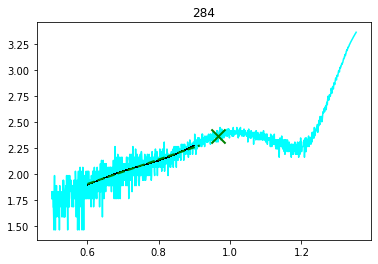

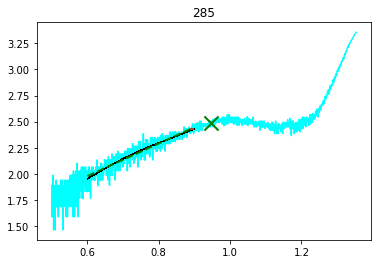

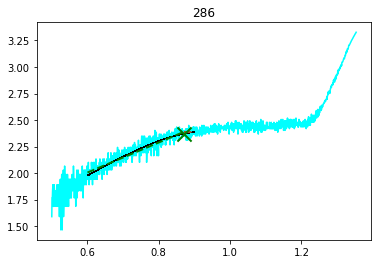

In [63]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})
warnings.filterwarnings('ignore')

column_names =  df_ylow_log.columns

limits_max= range(limits_max_lower_i,limits_max_upper_i+1,1) # row indexes
df_limits_max=df_ylow_log.iloc[limits_max,:]
E_limits_max=E.iloc[limits_max]

#collect all of the slopes and intercepts for the two parts
Epass_E, Epass_j = [],[]

#initialise the two models for part 1 and part 2
model1 = LinearRegression()
model2 = LinearRegression()

for (index, column) in enumerate(column_names):
    fig, ax = plt.subplots() 
    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)

    ax.set_title(column)
       
    maxval=argrelmax(df_limits_max[column].values,order=2)

    # Initialize the r2 values
    r2_final1, r2_final2 = 0, 0
    
    if column in class3:
        
        limits_pass = range(interval_lower_ipass3,interval_upper_ipass3+1,1)
    
    else:
        
        limits_pass = range(interval_lower_ipass,interval_upper_ipass+1,1)   
        
    if column not in no_passive_class: # no_passive_class --> no Epass

        for limit in limits_pass:

            ax.plot(E.iloc[limits_pass[0]:limits_pass[-1]+1],df_ylow_log[column].iloc[limits_pass[0]:limits_pass[-1]+1], color = "black",linewidth=0.5,zorder=2)

             #split the data into the first part and second part
            dfE_1 =  E.iloc[limits_pass[0]:limit+1]
            dfE_2 =  E.iloc[limit:limits_pass[-1]+1] 
            dfj_1 =  df_ylow_log.iloc[limits_pass[0]:limit+1] 
            dfj_2 =  df_ylow_log.iloc[limit:limits_pass[-1]+1] 
            X1,X2 = dfE_1.values.reshape(-1, 1),dfE_2.values.reshape(-1, 1)
            y1,y2 = dfj_1[column].values.reshape(-1, 1),dfj_2[column].values.reshape(-1, 1)

            # Fit models
            regr1, regr2 = model1.fit(X1, y1), model2.fit(X2, y2)
    
            # Evaluate models
            r2_score1, r2_score2 = r2_score(y1, regr1.predict(X1)), r2_score(y2, regr2.predict(X2))

            # Store best models
            if r2_score1 > r2_final1:
                r2_final1, regr_final1 = r2_score1, regr1
            if r2_score2 > r2_final2:
                r2_final2, regr_final2 = r2_score2, regr2

        # Determine intersection
        a1, a2 = regr_final1.coef_[0], regr_final2.coef_[0]
        b1, b2 = regr_final1.intercept_, regr_final2.intercept_

        x_intersect = np.around((b1-b2)/(a2-a1),3)
        E_tempo=E.round(3)
        try:
            xi=E_tempo[E_tempo<=x_intersect.item()].index[-1]
        except:
            xi=E_tempo[E_tempo>=x_intersect.item()].index[0]

        try:
            # plot the best-fit lines up to the intersection
            x1_reg,x2_reg  = E.iloc[limits_pass[0]:xi+1],E.iloc[xi:limits_pass[-1]+1]
            y1_reg,y2_reg  = x1_reg * a1 + b1,x2_reg * a2 + b2 

            ax.plot(x1_reg, y1_reg, linewidth = 2, color = 'green', linestyle = 'dashed')
            ax.plot(x2_reg, y2_reg, linewidth = 2, color = 'sienna', linestyle = 'dashed')

            if len(maxval[0]) > 0:
                if column in class2: # --> maxval
                    ax.scatter(E_limits_max.iloc[maxval[0][0]], df_limits_max[column].iloc[maxval[0]], marker='x',s=200, c='g',linewidths=2,zorder=3)
                    Epass_E.append(E_limits_max.iloc[maxval[0][0]])
                    Epass_j.append(df_limits_max[column].iloc[maxval[0][0]])         
                else: # all other classses --> maxval
                    MEANE=np.mean([E.iloc[xi],E_limits_max.iloc[maxval[0][0]]]) # mean between maxval and LR
                    ax.scatter(MEANE, df_ylow_log[column][E>= MEANE].iloc[0], marker='x',s=200, c='g',linewidths=2,zorder=3)    
                    Epass_E.append(MEANE)
                    Epass_j.append(df_ylow_log[column][E>= MEANE].iloc[0])
            else: # len(maxval[0]) = 0:
                ax.scatter(E.iloc[xi], df_ylow_log[column].iloc[xi], marker='x',s=200, c='g',linewidths=2,zorder=3)     
                Epass_E.append(E.iloc[xi])
                Epass_j.append(df_ylow_log[column].iloc[xi])      
        except:
            print(column)
    else: # no_passive_class --> np.nan
        Epass_E.append(np.nan) 
        Epass_j.append(np.nan)

### storing the Epass (x,y) values in a df

In [98]:
pass_log = pd.DataFrame({"Epass_x":Epass_E,"Epass_y":Epass_j})
pass_log.index=df_ylow_log.columns
pass_log.index.name="Maps"
pass_log

,Epass_x,Epass_y
Maps,,
0,0.922727,2.975687
1,0.955077,3.075050
2,0.950041,3.125495
3,0.946837,3.144655
4,0.945769,3.246714
...,...,...
282,0.955840,2.317934
283,0.959655,2.396768
284,0.965758,2.367897


### storing the Epit (x,y) and Epass (x,y) values in a df (and exporting it as a CSV file)

In [99]:
# choosing the directory
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

pit_pass_log=pd.concat([pit_log,pass_log],axis=1)
pit_pass_log.to_csv('Epit_Epass_0005_100.csv', index=True)
pit_pass_log

,Epit_x,Epit_y,Epass_x,Epass_y
Maps,,,,
0,1.194634,3.054879,0.922727,2.975687
1,1.205900,3.194629,0.955077,3.075050
2,1.202963,3.217619,0.950041,3.125495
3,1.192994,3.206268,0.946837,3.144655
4,1.177276,3.257952,0.945769,3.246714
...,...,...,...,...
282,1.215518,2.368995,0.955840,2.317934
283,1.216803,2.441111,0.959655,2.396768
284,1.221817,2.396670,0.965758,2.367897


###  uploading the Epit (x,y) and Epass (x,y) values as originally produced 
#### reproduced in "Estimating pitting descriptors of 316L stainless steel by machine learning and statistical analysis"

In [100]:
# choosing the directory for uploading the dataset originally produced (to account for the stochastic nature of ANN outputs)
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

pit_pass_log=pd.read_csv('Epit_Epass_0005_100.csv',index_col=0) #
pit_pass_log

,Epit_x,Epit_y,Epass_x,Epass_y
Maps,,,,
0,1.195019,3.057258,0.922727,2.975687
1,1.209487,3.205408,0.955077,3.075050
2,1.207027,3.229738,0.950041,3.125495
3,1.197898,3.219398,0.946837,3.144655
4,1.204865,3.311200,0.945769,3.246714
...,...,...,...,...
282,1.202606,2.338172,0.955840,2.317934
283,1.222891,2.462154,0.959655,2.396768
284,1.238532,2.476344,0.965758,2.367897


#### dataset uploaded above is permanently stored at: https://data.mendeley.com/datasets/5x4dmc38bg/1
Bertolucci Coelho, Leonardo; Ustarroz, Jon (2023), “Epit and Epass descriptors of 316L stainless steel estimated by Machine Learning”, Mendeley Data, V1, doi: 10.17632/5x4dmc38bg.1

# Statistical analysis

#### importing theoretical fitting distributions

In [106]:
!pip install distfit


[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [107]:
from distfit import distfit
from scipy.stats import norm

#### computing the mean and median values of the Epit_y and Epass_y (log(j)) distributions for plotting histograms

In [101]:
Epass_y_mean=np.mean(pit_pass_log['Epass_y'])
Epass_y_median=np.nanpercentile(pit_pass_log['Epass_y'],50)

Epit_y_mean05=np.mean(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5]) # excluding values when Epass = 0.5 V 
Epit_y_median05=np.nanpercentile(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5],50) # excluding values when Epass = 0.5 V 

#### Kernel Density Estimation (KDE) of the bivariate distributions of Epit/log(jpit) and  Epass/log(jpass)

https://stackoverflow.com/questions/31198020/how-to-find-local-maxima-in-kernel-density-estimation

In [102]:
def estimate_maxima(data):
    data.dropna(inplace=True)
    k = kde.gaussian_kde(data)
    no_samples = len(data)
    samples = np.linspace(data.min(), data.max(), no_samples)
    probs = k.evaluate(samples)
    maxima_index = probs.argmax()
    maxima = samples[maxima_index]
    return maxima

In [103]:
Epit_x_kde,Epit_y_kde=estimate_maxima(pit_pass_log["Epit_x"]),estimate_maxima(pit_pass_log["Epit_y"])
Epass_x_kde,Epass_y_kde=estimate_maxima(pit_pass_log["Epass_x"]),estimate_maxima(pit_pass_log["Epass_y"])

### plotting histograms of Epit_x and Epass_x (Epit and Epass (V))

In [104]:
# excluding outliers for curve fitting purpose
Epit=pit_pass_log['Epit_x'][round(pit_pass_log['Epit_x'],2)!=0.5]
Epass=pit_pass_log['Epass_x'] 

Epit_sort=np.sort(Epit)
Epass_sort=np.sort(Epass.dropna()) 

def Zscore_outliers(data):
    outliers =[]
    threshold=3 # 3 x std
    mean=np.mean(data)
    std=np.std(data)
    for i in data:
        z_score=(i-mean)/std
        if np.abs(z_score) > threshold:
            outliers.append(i)
    return outliers

Zscore_outliers_list_Epit=Zscore_outliers(Epit_sort)
Zscore_outliers_list_Epass=Zscore_outliers(Epass_sort)

maskpit = Epit.isin(Zscore_outliers_list_Epit)
maskpass = Epass.isin(Zscore_outliers_list_Epass)

not_in_list_maskpit = ~maskpit
not_in_list_maskpass = ~maskpass
df_not_in_listpit = Epit.loc[not_in_list_maskpit]
df_not_in_listpass = Epass.loc[not_in_list_maskpass]

norm RSS: 64.11507157288476
norm RSS: 622.6937788847181


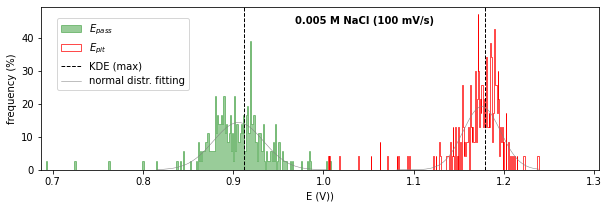

In [108]:
unique_pass=np.unique(pit_pass_log['Epass_x']) 
unique_pit=np.unique(pit_pass_log['Epit_x'][round(pit_pass_log['Epit_x'],2)!=0.5]) 
bins_pass=len(unique_pass)
bins_pit=len(unique_pit)

fig, ax = plt.subplots(figsize=(10,3))

ax.hist(pit_pass_log['Epass_x'],density=True,bins=bins_pass,color="green",fill=True,histtype='step',alpha=0.4,label="$E_{pass}$")

ax.hist(pit_pass_log['Epit_x'][round(pit_pass_log['Epit_x'],2)!=0.5], density=True,bins=bins_pit,color="red",fill=False,histtype='step',linewidth=0.7,label="$E_{pit}$")

ax.axvline(x = Epass_x_kde,color = 'k',linestyle = 'dashed',linewidth = 1,zorder=2,label="KDE (max)")
ax.axvline(x = Epit_x_kde,color = 'k',linestyle = 'dashed',linewidth = 1,zorder=2)

ax.set_xlabel("E (V))")
ax.set_ylabel("frequency (%)")
ax.set_xlim(0.687,1.305)
ax.set_title("0.005 M NaCl (100 mV/s)",fontsize = 10, y=0.86,x=0.58,weight='bold') 

#without outliers
Epass_sortwo=np.sort(df_not_in_listpass.dropna())
xpass=np.linspace(Epass_sortwo[0],Epass_sortwo[-1],len(unique_pass)) 
dist = distfit(distr="norm",smooth=20,bins=round(len(unique_pass)/2)) 
dist.fit_transform(Epass_sortwo, verbose=1)  
print(dist.model['name']+" RSS: "+str(dist.model['score'])) 
model=norm.pdf(xpass, dist.model['params'][0],dist.model['params'][1])
ax.plot(xpass,model,"grey",linewidth=0.5,label="normal distr. fitting")

Epit_sortwo=np.sort(df_not_in_listpit.dropna())
xpit=np.linspace(Epit_sortwo[0],Epit_sortwo[-1],len(unique_pit)) 
dist = distfit(distr="norm",smooth=20,bins=round(len(unique_pit)/2)) 
dist.fit_transform(Epit_sortwo, verbose=1)  
print(dist.model['name']+" RSS: "+str(dist.model['score'])) 
model=norm.pdf(xpit, dist.model['params'][0],dist.model['params'][1])
ax.plot(xpit,model,"grey",linewidth=0.5)

fig.legend(loc="upper left", bbox_to_anchor=(0.14, 0.85))

### plotting histograms of Epit_y and Epass_y (log(jpit) and log(jpass) (µA/cm²))

unique_pass=np.unique(pit_pass_log['Epass_y']) 
unique_pit=np.unique(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5]) 
bins_pass=len(unique_pass)
bins_pit=len(unique_pit)

fig, ax = plt.subplots(figsize=(3,10))

ax.hist(pit_pass_log['Epass_y'],density=True,bins=bins_pass,color="green",fill=True,histtype='step',alpha=0.4,orientation="horizontal",label="$log(j_{pass})$")
ax.axhline(y = Epass_y_mean, color = 'green', linewidth = 1.5,zorder=2,label="mean")
ax.axhline(y = Epass_y_median, color = 'green',linestyle = 'dashed',linewidth = 1,zorder=2,label="median")

ax.hist(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5], density=True,bins=bins_pit,color="red",fill=False,histtype='step',linewidth=0.7,orientation="horizontal",label="$log(j_{pit})$")
ax.axhline(y = Epit_y_mean05, color = 'red', linewidth = 1.5,zorder=2,label="mean")
ax.axhline(y = Epit_y_median05, color = 'red',linestyle = 'dashed',linewidth = 1,zorder=2,label="median")

ax.scatter(0,Epass_y_kde,marker="o",s=200,facecolors='none',edgecolors="g",linewidth=2,label="KDE (max)")
ax.scatter(0,Epit_y_kde,marker="o",s=200,facecolors='none',edgecolors="r",linewidth=2,label="KDE (max)")

ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("frequency (%)")
fig.legend(loc="upper left", bbox_to_anchor=(0.45, 0.85))
ax.set_ylim(min(pit_pass_log['Epit_y'])-0.01,max(pit_pass_log['Epit_y'])+0.01) 
ax.set_xlim(0,8) 
ax.set_title("0.005 M NaCl (100 mV/s)",fontsize = 10, y=0.96,x=0.55,weight='bold') 

### hypothesis testing
#### null hypothesis 1: the Epass (V) is normally distributed
#### null hypothesis 2: the Epit (V) is normally distributed

Since the p-value is less than 0.05, we reject the null hypothesis. 
We have sufficient evidence to say that the sample data does not come from a normal distribution.

Since the p-value is not less than 0.05, we fail to reject the null hypothesis. 
We do not have sufficient evidence to say that the sample data does not come from a normal distribution.

#### normality tests

In [110]:
from scipy.stats import shapiro, normaltest, anderson

def test_normality(data, hypothesis_num):
    # Shapiro-Wilk Test
    stat, p = shapiro(data)
    print(f"p={p:.3f}")
    if p < 0.05:
        print(f"The null hypothesis {hypothesis_num} can be rejected")
    else:
        print(f"The null hypothesis {hypothesis_num} cannot be rejected: normal distribution")

    # D'Agostino and Pearson's Test
    stat, p = normaltest(data)
    print(f"p={p:.3f}")
    if p < 0.05:
        print(f"The null hypothesis {hypothesis_num} can be rejected")
    else:
        print(f"The null hypothesis {hypothesis_num} cannot be rejected: normal distribution")
    
    # Anderson-Darling Test
    result = anderson(data)
    for i in range(len(result.critical_values)):
        slevel, cvalues = result.significance_level[i], result.critical_values[i]
        if result.statistic < result.critical_values[i]:
            print(f'{slevel:.3f}: {cvalues:.3f}, data looks normal (fail to reject H0)')
        else:
            print(f'{slevel:.3f}: {cvalues:.3f}, data does not look normal (reject H0)')

# Testing normality for Epass_sort and Epit_sort
print("Epass")
test_normality(Epass_sort, 1)
print("\nEpit")
test_normality(Epit_sort, 2)

# Testing normality for Epass_sortwo and Epit_sortwo (without outliers)
print("\nEpass w/o outliers")
test_normality(Epass_sortwo, 1)
print("\nEpit w/o outliers")
test_normality(Epit_sortwo, 2)

Epass
p=0.000
The null hypothesis 1 can be rejected
p=0.000
The null hypothesis 1 can be rejected
15.000: 0.568, data does not look normal (reject H0)
10.000: 0.647, data does not look normal (reject H0)
5.000: 0.776, data does not look normal (reject H0)
2.500: 0.906, data does not look normal (reject H0)
1.000: 1.077, data does not look normal (reject H0)

Epit
p=0.000
The null hypothesis 2 can be rejected
p=0.000
The null hypothesis 2 can be rejected
15.000: 0.568, data does not look normal (reject H0)
10.000: 0.647, data does not look normal (reject H0)
5.000: 0.776, data does not look normal (reject H0)
2.500: 0.906, data does not look normal (reject H0)
1.000: 1.077, data does not look normal (reject H0)

Epass w/o outliers
p=0.012
The null hypothesis 1 can be rejected
p=0.012
The null hypothesis 1 can be rejected
15.000: 0.568, data does not look normal (reject H0)
10.000: 0.647, data does not look normal (reject H0)
5.000: 0.776, data does not look normal (reject H0)
2.500: 0.9

### mean, IQR and selected quantiles for the log(j) distributions 

In [111]:
# mean of log(j)
m=df_log.mean(axis=1) 

quantile_min=np.nanpercentile(df_log, 0.35,axis=1) 
Q1=np.nanpercentile(df_log,25,axis=1)
median=np.nanpercentile(df_log,50,axis=1)
Q3=np.nanpercentile(df_log,75,axis=1)
quantile_max=np.nanpercentile(df_log, 99.65,axis=1) 
IQR=pd.DataFrame({"Qmin":quantile_min,"Q1":Q1,"median":median,"Q3":Q3,"Qmax":quantile_max,"mean":m}) 
IQR

,Qmin,Q1,median,Q3,Qmax,mean
0,1.464660,2.191533,2.242686,2.366462,2.928690,2.261369
1,1.589650,2.191533,2.266167,2.363662,2.911875,2.266477
2,1.686383,2.163505,2.242686,2.347595,2.899965,2.255555
3,1.765565,2.191533,2.266167,2.361100,2.899686,2.271771
4,1.589650,2.163505,2.242686,2.342376,2.898117,2.251242
...,...,...,...,...,...,...
1103,2.951479,3.957201,4.005031,4.075724,5.444657,4.064470
1104,2.956173,3.963993,4.008189,4.078552,5.442008,4.069823
1105,2.965408,3.967644,4.013129,4.081704,5.454030,4.073703
1106,2.960821,3.969684,4.015985,4.089846,5.449184,4.077855


#### smoothing the IQR values of log(j) 

In [112]:
IQR_ylow_log = IQR.copy()

column_names =  IQR.columns
for index, column in enumerate(column_names):
        
    lowess = sm.nonparametric.lowess
    ylow = lowess(IQR[column],E,frac= 0.2,return_sorted=False)
    IQR_ylow_log[column]=ylow
    
IQR_ylow_log

,Qmin,Q1,median,Q3,Qmax,mean
0,1.636476,2.160586,2.244160,2.338294,2.927566,2.246109
1,1.637849,2.161798,2.245363,2.339832,2.928578,2.247411
2,1.639908,2.163616,2.247168,2.342141,2.930095,2.249366
3,1.641281,2.164829,2.248371,2.343681,2.931106,2.250669
4,1.643341,2.166648,2.250175,2.345991,2.932622,2.252625
...,...,...,...,...,...,...
1103,3.024483,3.944824,4.008140,4.056050,5.573988,4.047017
1104,3.029035,3.949779,4.013103,4.059744,5.581577,4.051770
1105,3.032066,3.953083,4.016413,4.062207,5.586636,4.054939
1106,3.036608,3.958039,4.021377,4.065901,5.594221,4.059694


### plotting the KDE of Epit/log(jpit) and Epass/log(jpass) with selected quantile curves of log(j)

Text(0.5, 0.94, '0.005 M NaCl (100 mV/s)')

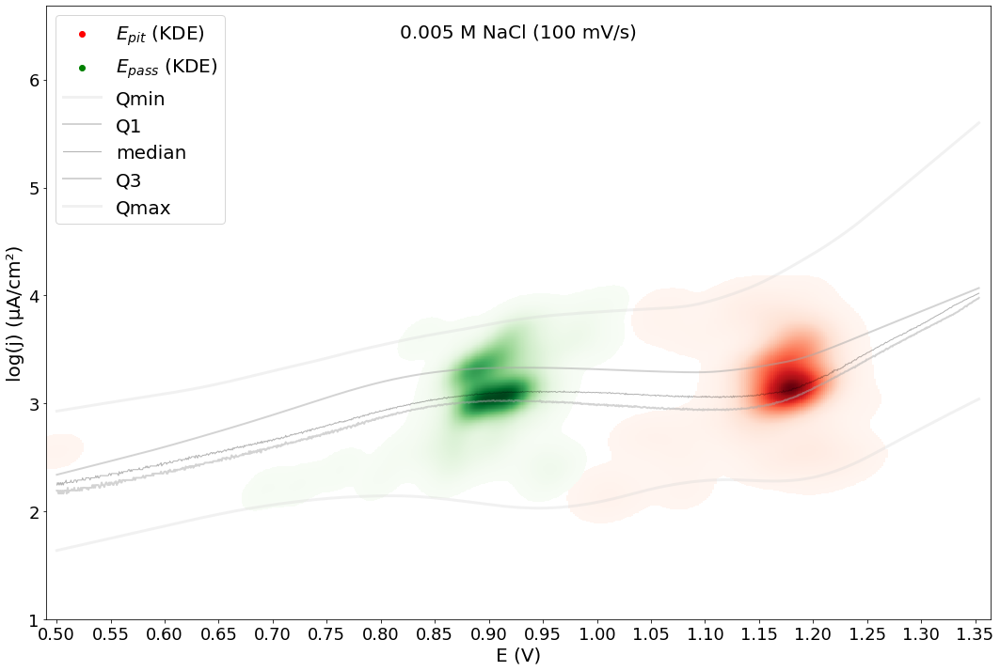

In [113]:
nbinspass= 500
nbins= 500

k = kde.gaussian_kde([pit_pass_log["Epit_x"],pit_pass_log["Epit_y"]])
xipit, yipit = np.mgrid[pit_pass_log["Epit_x"].min()-0.08:pit_pass_log["Epit_x"].max()+0.08:nbins*1j, pit_pass_log["Epit_y"].min()-0.8:pit_pass_log["Epit_y"].max()+0.8:nbins*1j]
zipit = k(np.vstack([xipit.flatten(), yipit.flatten()]))
z = np.ma.masked_array(zipit, zipit < 0.1)

k2 = kde.gaussian_kde([pit_pass_log["Epass_x"].dropna(),pit_pass_log["Epass_y"].dropna()])
xipass, yipass = np.mgrid[pit_pass_log["Epass_x"].min()-0.08:pit_pass_log["Epass_x"].max()+0.08:nbinspass*1j, pit_pass_log["Epass_y"].min()-0.8:pit_pass_log["Epass_y"].max()+0.8:nbins*1j]
zipass = k2(np.vstack([xipass.flatten(), yipass.flatten()]))
z2 = np.ma.masked_array(zipass, zipass < 0.1)

fig, ax = plt.subplots(figsize=(18, 12)) 

plt.pcolormesh(xipit, yipit, z.reshape(xipit.shape), shading='auto',cmap="Reds") 

plt.pcolormesh(xipass, yipass, z2.reshape(xipass.shape), shading='auto',cmap="Greens")

ax.scatter(0,0,color="red",label="$E_{pit}$ (KDE)") # plot for the sake of the legend label
ax.scatter(0,0,color="green",label="$E_{pass}$ (KDE)") # plot for the sake of the legend label

ax.plot(E , IQR_ylow_log["Qmin"],color="lightgrey",linewidth=3,label="Qmin",alpha=0.3,zorder=1)    
ax.plot(E , IQR["Q1"], color="darkgray",linewidth=2,label="Q1",alpha=0.5,zorder=1) 
ax.plot(E , IQR["median"], color="k",linewidth=1,label="median",alpha=0.3,zorder=1) 
ax.plot(E , IQR_ylow_log["Q3"],color="darkgray",linewidth=2,label="Q3",alpha=0.5,zorder=1) 
ax.plot(E , IQR_ylow_log["Qmax"], color="lightgrey",linewidth=3,label="Qmax",alpha=0.3,zorder=1) 

ax.legend( loc ="upper left",prop={'size': 20})
ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=18)
ax.xaxis.label.set_size(20)
ax.yaxis.label.set_size(20)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(np.log10(10), np.log10(4800000)) 

ax.set_title("0.005 M NaCl (100 mV/s)",fontsize = 20, y=0.94) 

## Epit and Epass estimations from the IQR and selected quantiles

### Epass

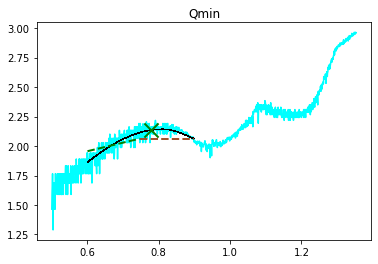

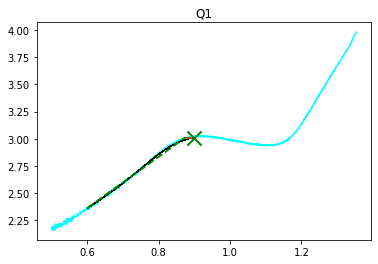

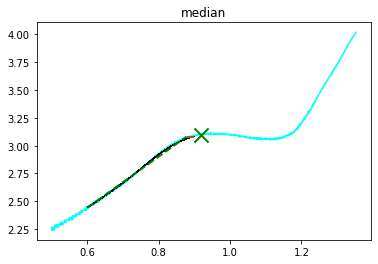

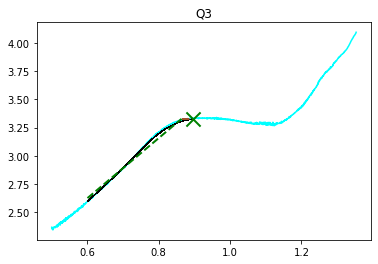

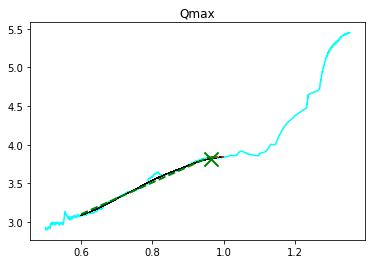

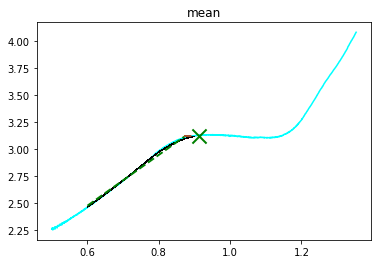

In [114]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})
warnings.filterwarnings('ignore')

column_names =  IQR.columns

limits_max= range(limits_max_lower_i,limits_max_upper_i+1,1) 
df_limits_max=IQR_ylow_log.iloc[limits_max,:]
E_limits_max=E.iloc[limits_max]

#collect all of the slopes and intercepts for the two parts
XIQR_pass_E, XIQR_pass_j = [],[]

#initialise the two models for part 1 and part 2
model1 = LinearRegression()
model2 = LinearRegression()

for (index, column) in enumerate(column_names):
    fig, ax = plt.subplots() 
    
    ax.plot(E , IQR[column], color = "cyan",zorder=1)

    ax.set_title(column)
       
    maxval=argrelmax(df_limits_max[column].values,order=2)

    #initialise the r2 values
    r2_final1 = 0
    r2_final2 = 0
    
    if column=="Qmax":
        
        limits_pass = range(interval_lower_ipass3,interval_upper_ipass3+1,1)
    
    else:
        
        limits_pass = range(interval_lower_ipass,interval_upper_ipass+1,1)    

    for limit in limits_pass:

        ax.plot(E.iloc[limits_pass[0]:limits_pass[-1]+1],IQR_ylow_log[column].iloc[limits_pass[0]:limits_pass[-1]+1], color = "black",linewidth=0.5,zorder=2) # ylow

         #split the data into the first part and second part
        dfE_1 =  E.iloc[limits_pass[0]:limit+1]
        dfE_2 =  E.iloc[limit:limits_pass[-1]+1] 
        dfj_1 =  IQR_ylow_log.iloc[limits_pass[0]:limit+1] 
        dfj_2 =  IQR_ylow_log.iloc[limit:limits_pass[-1]+1] 
        X1 = dfE_1.values.reshape(-1, 1)
        X2 = dfE_2.values.reshape(-1, 1) 
        y1 = dfj_1[column].values.reshape(-1, 1)
        y2 = dfj_2[column].values.reshape(-1, 1) 

    #fit two regression models on the different parts
        regr1 = model1.fit(X1, y1) 
        regr2 = model2.fit(X2, y2)

    # predict data using a first order linear regression
        y_pred1 = regr1.predict(X1)
        y_pred2 = regr2.predict(X2)

    #check how well the data fits on the training data
        r2_score1 = r2_score(y1, y_pred1) 
        r2_score2 = r2_score(y2, y_pred2)

    #find the best r2 for the different limits
        if r2_score1 > r2_final1: 
            r2_final1 = r2_score1
            regr_final1 = regr1

        if r2_score2 > r2_final2: 
            r2_final2 = r2_score2
            regr_final2 = regr2

#find the intersection point for each column
    a1 = regr_final1.coef_[0]
    a2 = regr_final2.coef_[0]
    b1 = regr_final1.intercept_
    b2 = regr_final2.intercept_

    x_intersect = np.around((b1-b2)/(a2-a1),3) # x value
    E_tempo=E.round(3)
    try:
        xi=E_tempo[E_tempo<=x_intersect.item()].index[-1]
    except:
        xi=E_tempo[E_tempo>=x_intersect.item()].index[0]

    try:
#plot the graps to where the interstion point lays, in other words change the limit to that value
        x1_reg=E.iloc[limits_pass[0]:xi+1]
        x2_reg=E.iloc[xi:limits_pass[-1]+1]
        y1_reg = x1_reg*a1 + b1
        y2_reg = x2_reg*a2 + b2      

        ax.plot(x1_reg, y1_reg, linewidth = 2, color = 'green', linestyle = 'dashed')
        ax.plot(x2_reg, y2_reg, linewidth = 2, color = 'sienna', linestyle = 'dashed')

        if len(maxval[0]) > 0:
            MEANE=np.mean([E.iloc[xi],E_limits_max.iloc[maxval[0][0]]]) # mean between maxval and LR
            ax.scatter(MEANE, IQR_ylow_log[column][E>= MEANE].iloc[0], marker='x',s=200, c='g',linewidths=2,zorder=3)
            XIQR_pass_E.append(MEANE)
            XIQR_pass_j.append(IQR_ylow_log[column][E>= MEANE].iloc[0])
        else: # len(maxval[0]) = 0:
            ax.scatter(E.iloc[xi], IQR_ylow_log[column].iloc[xi], marker='x',s=200, c='g',linewidths=2,zorder=3)      
            XIQR_pass_E.append(E.iloc[xi])
            XIQR_pass_j.append(IQR_ylow_log[column].iloc[xi])      
    except:
        print(column)

### Epit

#### ML

In [116]:
Xquantile_min=np.nanpercentile(j_transp_scaled, 0.35,axis=0) 
XQ1=np.nanpercentile(j_transp_scaled,25,axis=0)
Xmedian=np.nanpercentile(j_transp_scaled,50,axis=0)
XQ3=np.nanpercentile(j_transp_scaled,75,axis=0)
Xquantile_max=np.nanpercentile(j_transp_scaled, 99.65,axis=0)
Xmean=np.mean(j_transp_scaled,axis=0)
XIQR=pd.DataFrame({"Qmin":Xquantile_min,"Q1":XQ1,"median":Xmedian,"Q3":XQ3,"Qmax":Xquantile_max,"mean":Xmean}) 
XIQR=XIQR.T
XIQR.columns=j_transp_scaled.columns
XIQR  # Qmax: out of the scope of ML

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
Qmin,-3.285163e+00,-3.287921e+00,-3.292008e+00,-3.296033e+00,-3.298681e+00,-3.302600e+00,-3.305177e+00,-3.308989e+00,-3.311494e+00,-3.315196e+00,...,-3.016814e+00,-3.014462e+00,-3.010806e+00,-3.008281e+00,-3.004359e+00,-3.001653e+00,-2.997453e+00,-2.993084e+00,-2.989501e+00,-2.984063e+00
Q1,-3.162840e-01,-3.161713e-01,-3.175593e-01,-3.192325e-01,-3.202320e-01,-3.195044e-01,-3.197860e-01,-3.208447e-01,-3.215514e-01,-3.226127e-01,...,-3.429978e-01,-3.419875e-01,-3.404897e-01,-3.396358e-01,-3.383807e-01,-3.375524e-01,-3.344896e-01,-3.330324e-01,-3.321630e-01,-3.332935e-01
median,-1.290722e-01,-1.282662e-01,-1.270674e-01,-1.258811e-01,-1.250975e-01,-1.239333e-01,-1.231647e-01,-1.220238e-01,-1.212710e-01,-1.201540e-01,...,-1.703937e-01,-1.686138e-01,-1.659553e-01,-1.654069e-01,-1.614050e-01,-1.617178e-01,-1.617227e-01,-1.617497e-01,-1.613392e-01,-1.588226e-01
Q3,6.879449e-01,6.862798e-01,6.839095e-01,6.826248e-01,6.817716e-01,6.825269e-01,6.820660e-01,6.801167e-01,6.788248e-01,6.768988e-01,...,3.165024e-01,3.148288e-01,3.117009e-01,3.095972e-01,3.064142e-01,3.046651e-01,3.039339e-01,3.014720e-01,3.003182e-01,2.978390e-01
Qmax,1.868350e+00,1.871189e+00,1.875449e+00,1.879707e+00,1.882543e+00,1.886793e+00,1.889622e+00,1.893859e+00,1.896677e+00,1.900895e+00,...,3.364962e+00,3.359485e+00,3.351226e+00,3.345686e+00,3.337319e+00,3.331700e+00,3.323206e+00,3.314628e+00,3.309496e+00,3.301746e+00
mean,6.211038e-18,-7.049528e-16,-8.167515e-16,-8.540177e-17,-4.829082e-16,1.624186e-15,-8.136460e-16,2.639691e-17,-2.329139e-16,1.026374e-15,...,-1.430091e-15,1.285685e-15,-6.273148e-16,-4.735916e-16,5.838376e-16,-1.723563e-16,-4.766972e-16,4.099285e-16,7.763797e-17,6.645811e-16


#### selection of input features 

In [117]:
# reducing the complexity of the IQR curves by diminishing its dimensionality: selecting every 40th feature from the "XIQR" df
XIQR_red=XIQR.copy()
XIQR_red=XIQR_red[np.arange(0,XIQR.shape[1],40)]
XIQR_red

,0,40,80,120,160,200,240,280,320,360,400,440,480
Qmin,-3.285163e+00,-3.386785e+00,-3.345066e+00,-3.222295e+00,-3.144142e+00,-2.873351e+00,-2.486377e+00,-2.479514e+00,-2.667400e+00,-2.896332e+00,-3.037645e+00,-3.053974e+00,-3.040830e+00
Q1,-3.162840e-01,-3.273916e-01,-3.503803e-01,-3.907850e-01,-4.351271e-01,-4.546110e-01,-4.814154e-01,-4.968718e-01,-4.973103e-01,-4.621164e-01,-4.156869e-01,-3.664062e-01,-3.509678e-01
median,-1.290722e-01,-9.991162e-02,-8.868526e-02,-7.998164e-02,-8.687896e-02,-1.055129e-01,-1.102861e-01,-1.299809e-01,-1.677578e-01,-2.223498e-01,-2.595778e-01,-2.665454e-01,-1.760134e-01
Q3,6.879449e-01,6.421439e-01,6.234107e-01,6.046298e-01,5.947000e-01,5.781730e-01,5.590941e-01,5.273461e-01,5.795656e-01,5.910806e-01,5.240489e-01,3.892648e-01,3.277590e-01
Qmax,1.868350e+00,2.000964e+00,2.100624e+00,2.179549e+00,2.245054e+00,2.319330e+00,2.389870e+00,2.465557e+00,2.807824e+00,3.065087e+00,3.182577e+00,3.178361e+00,3.299595e+00
mean,6.211038e-18,-3.586874e-16,-1.189414e-15,4.409837e-16,-4.223506e-16,-2.329139e-16,-1.159911e-15,1.074510e-15,-8.074349e-16,7.530883e-16,2.670746e-16,-1.119540e-15,9.254446e-16


#### deploying the trained model on the IQR set

In [132]:
predict_IQR=model.predict(XIQR_red) 
predict_IQR

1/1 [==============================] - 0s 67ms/step


array([[1.149269 ],
       [1.1556077],
       [1.1659681],
       [1.1826919],
       [1.1776992],
       [1.1571395]], dtype=float32)

#### storing the Epit (x,y) and Epass (x,y) values of the IQR curves in a df 

In [133]:
index_names =  IQR.columns

Epit_x_IQR, Epit_y_IQR = [],[]
for e,(index,column) in zip(predict_IQR,enumerate(index_names)):
    Epit_x_IQR.append(e[0])
    Epit_y_IQR.append(IQR_ylow_log[column][E>=predict_IQR[index][0]].iloc[0])

pit_pass_IQR = pd.DataFrame({"Epit_x":Epit_x_IQR,"Epit_y":Epit_y_IQR,"Epass_x":XIQR_pass_E,"Epass_y":XIQR_pass_j})
pit_pass_IQR.index=IQR.columns
pit_pass_IQR.index.name="IQR"
pit_pass_IQR

,Epit_x,Epit_y,Epass_x,Epass_y
IQR,,,,
Qmin,1.149269,2.282402,0.777764,2.135609
Q1,1.155608,3.045781,0.899838,3.010322
median,1.165968,3.158633,0.918455,3.094146
Q3,1.182692,3.402410,0.897092,3.325298
Qmax,1.177699,4.254327,0.963469,3.819314
mean,1.157140,3.196361,0.912198,3.122428


In [163]:
# choosing the directory for uploading the IQR dataset originally produced (to account for the stochastic nature of ANN outputs)
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

pit_pass_IQR=pd.read_csv('Epit_Epass_0005_100_IQR.csv',index_col=0) 
pit_pass_IQR

,Epit_x,Epit_y,Epass_x,Epass_y
IQR,,,,
Qmin,1.234169,2.349195,0.777764,2.135609
Q1,1.171606,3.016797,0.899838,3.010322
median,1.181066,3.136633,0.918455,3.094146
Q3,1.170995,3.354001,0.897092,3.325298
Qmax,1.137216,4.057227,0.963469,3.819314
mean,1.153893,3.182366,0.912198,3.122428


## central tendency estimates of Epass/log(jpass) and Epit/log(jpit)
### comparison of estimates from the maximum KDE (ground truth) with the median and mean proxy models

In [137]:
#median absolute deviation 
from scipy.stats import median_abs_deviation

df_mad=median_abs_deviation(df_log,axis=1)

Text(0.5, 1.0, '0.005 M NaCl (100 mV/s)')

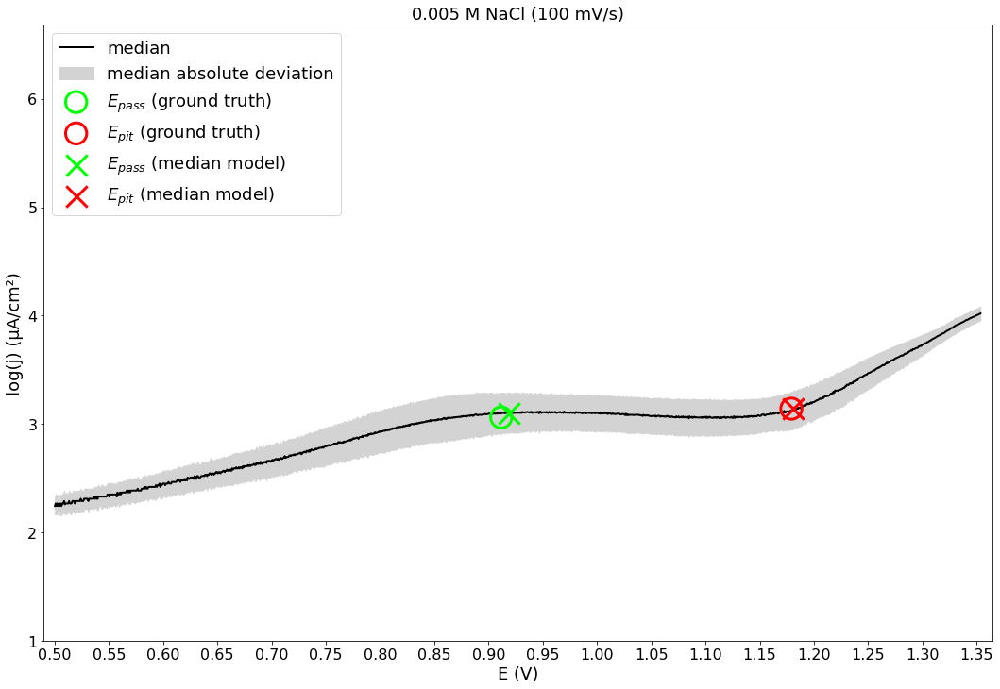

In [164]:
fig, ax = plt.subplots(figsize=(18, 12))

ax.plot(E,IQR["median"], color="k",linewidth=2,label="median")
ax.fill_between(E, IQR["median"]-df_mad, IQR["median"]+df_mad,color="lightgrey",label="median absolute deviation")

ax.scatter(Epass_x_kde,Epass_y_kde,marker="o",facecolors='none',edgecolors="lime",s=500,label="$E_{pass}$ (ground truth)",linewidths=3,zorder=2)
ax.scatter(Epit_x_kde,Epit_y_kde,marker="o",facecolors='none',edgecolors="r",s=500,label="$E_{pit}$ (ground truth)",linewidths=3,zorder=2)

ax.scatter(pit_pass_IQR.loc["median"]["Epass_x"],pit_pass_IQR.loc["median"]["Epass_y"],marker="x",c="lime",s=500,label="$E_{pass}$ (median model)",linewidths=3,zorder=2)
ax.scatter(pit_pass_IQR.loc["median"]["Epit_x"],pit_pass_IQR.loc["median"]["Epit_y"],marker="x",c="red",s=500,label="$E_{pit}$ (median model)",linewidths=3,zorder=2)

ax.legend( loc ="upper left",prop={'size': 18})
ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=16)
ax.xaxis.label.set_size(18)
ax.yaxis.label.set_size(18)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(np.log10(10), np.log10(4800000)) 

ax.set_title("0.005 M NaCl (100 mV/s)",fontsize = 18)

In [139]:
#standard deviation 
df_std=np.std(df_log,axis=1)
    
#standard error of the mean 
from scipy.stats import sem
df_sem=sem(df_log,axis=1) 

Text(0.5, 1.0, '0.005 M NaCl (100 mV/s)')

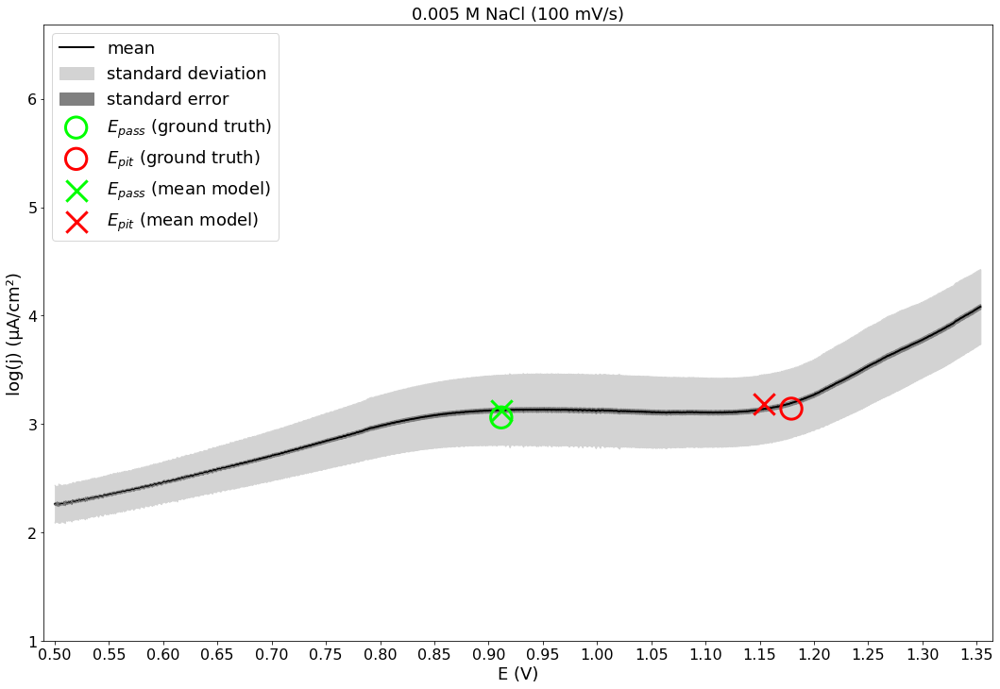

In [165]:
fig, ax = plt.subplots(figsize=(18, 12))
ax.plot(E,m, color="k",linewidth=2,label="mean")

ax.plot(E,m+df_std, color="lightgrey",linewidth=1)
ax.plot(E,m-df_std, color="lightgrey",linewidth=1)
ax.fill_between(E,  m-df_std, m+df_std,color="lightgrey",label="standard deviation")

ax.plot(E,m+df_sem, color="grey",linewidth=1)
ax.plot(E,m-df_sem, color="grey",linewidth=1)
ax.fill_between(E, m-df_sem, m+df_sem,color="grey",label="standard error")

ax.scatter(Epass_x_kde,Epass_y_kde,marker="o",facecolors='none',edgecolors="lime",s=500,label="$E_{pass}$ (ground truth)",linewidths=3,zorder=2)
ax.scatter(Epit_x_kde,Epit_y_kde,marker="o",facecolors='none',edgecolors="r",s=500,label="$E_{pit}$ (ground truth)",linewidths=3,zorder=2)

ax.scatter(pit_pass_IQR.loc["mean"]["Epass_x"],pit_pass_IQR.loc["mean"]["Epass_y"],marker="x",c="lime",s=500,linewidths=3,zorder=2,label="$E_{pass}$ (mean model)")
ax.scatter(pit_pass_IQR.loc["mean"]["Epit_x"],pit_pass_IQR.loc["mean"]["Epit_y"],marker="x",c="red",s=500,label="$E_{pit}$ (mean model)",linewidths=3,zorder=2)

ax.legend( loc ="upper left",prop={'size': 18})
ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=16)
ax.xaxis.label.set_size(18)
ax.yaxis.label.set_size(18)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(np.log10(10), np.log10(4800000)) 

ax.set_title("0.005 M NaCl (100 mV/s)",fontsize = 18)

### storing the ground truth values of Epass/log(jpass) and Epit/log(jpit) and the mean-/median-based estimates in a df (and exporting it as a CSV file)

In [166]:
residuals_mean_median = pd.DataFrame(
[[Epass_x_kde,
Epass_y_kde,
Epit_x_kde,
Epit_y_kde,
pit_pass_IQR.loc["median"]["Epass_x"],
pit_pass_IQR.loc["median"]["Epass_y"],
pit_pass_IQR.loc["median"]["Epit_x"],
pit_pass_IQR.loc["median"]["Epit_y"],
pit_pass_IQR.loc["mean"]["Epass_x"],
pit_pass_IQR.loc["mean"]["Epass_y"],
pit_pass_IQR.loc["mean"]["Epit_x"],
pit_pass_IQR.loc["mean"]["Epit_y"],
Epass_x_kde-pit_pass_IQR.loc["median"]["Epass_x"],
Epass_y_kde-pit_pass_IQR.loc["median"]["Epass_y"],
Epit_x_kde-pit_pass_IQR.loc["median"]["Epit_x"],
Epit_y_kde-pit_pass_IQR.loc["median"]["Epit_y"],
Epass_x_kde-pit_pass_IQR.loc["mean"]["Epass_x"],
Epass_y_kde-pit_pass_IQR.loc["mean"]["Epass_y"],
Epit_x_kde-pit_pass_IQR.loc["mean"]["Epit_x"],
Epit_y_kde-pit_pass_IQR.loc["mean"]["Epit_y"]]], 
columns=["Epass","jpass","Epit","jpit",
        'median Epass','median jpass','median Epit','median jpit','mean Epass','mean jpass','mean Epit','mean jpit',
        'median Epass res','median jpass res','median Epit res','median jpit res','mean Epass res','mean jpass res','mean Epit res','mean jpit res'],
index=[0])
# choosing the directory 
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")
residuals_mean_median.to_csv('residuals_mean_median_0005_100.csv', index=True)
residuals_mean_median

,Epass,jpass,Epit,jpit,median Epass,median jpass,median Epit,median jpit,mean Epass,mean jpass,mean Epit,mean jpit,median Epass res,median jpass res,median Epit res,median jpit res,mean Epass res,mean jpass res,mean Epit res,mean jpit res
0,0.911684,3.060153,1.179156,3.140989,0.918455,3.094146,1.181066,3.136633,0.912198,3.122428,1.153893,3.182366,-0.00677,-0.033993,-0.001911,0.004356,-0.000514,-0.062275,0.025263,-0.041378


### Population of experimental log(j) Vs E curves

(1.1, 5.5)

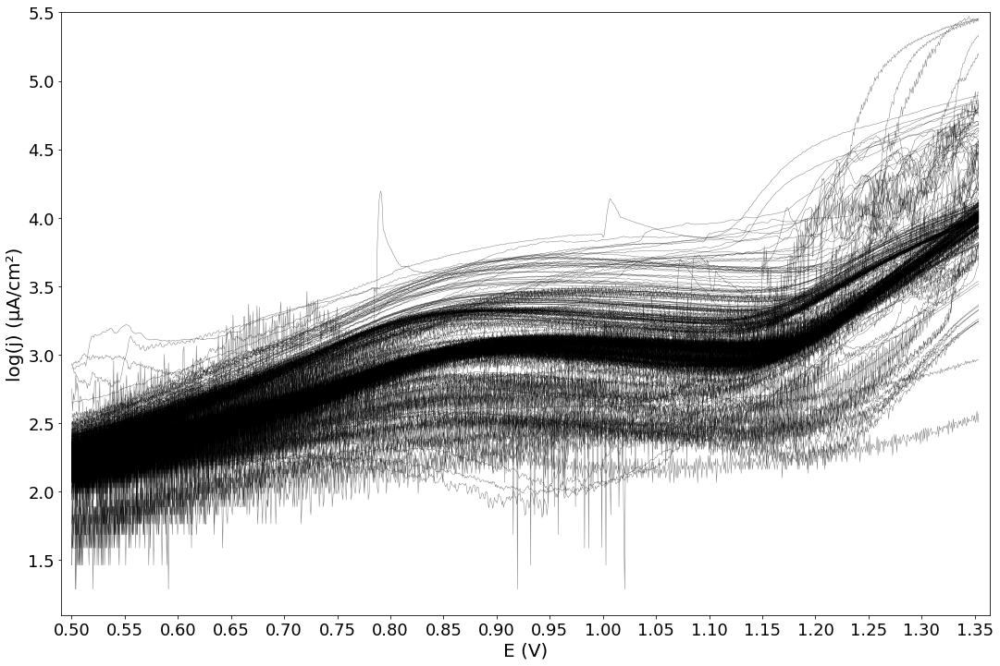

In [167]:
fig, ax = plt.subplots(figsize=(18, 12))

ax.plot(E , df_log, color="k",linewidth=0.5,alpha=0.5,zorder=1) # all curves

ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=18)
ax.xaxis.label.set_size(20)
ax.yaxis.label.set_size(20)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(1.1, 5.5) 